In [1]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
sns.set(style="darkgrid")

# Define Python functions to be used
Using the listdir method to list files in directories. There are many independent directories to be access,  
a function will be created for the ensuing repetitive task.

In [2]:
def set_DfName(File):
    '''This function will extract unique string from file name to name the data frame'''
    CheckList=['LoAv','PhMem','Procs']
    spllist=File.split('_')
    if spllist[0] in CheckList:
        Name= spllist[1]+'_'+spllist[2].split('.')[0]
    else:
        Name = spllist[0]
    return Name
                      
def get_ListOfDataFrames(directory):
    files = os.listdir(directory)
    DfObjList={}
    for file in files:
        Name=set_DfName(file)
        DfObjList[Name]=pd.read_csv('%s/%s'%(directory,file))
    return DfObjList

#We will select files of interest
#def set_DfNameSift(File):
##    '''This function will extract specified file name to name the data frame'''
#    CheckList=['imac025328','imac023305','imac021072','imac023307','imac021547','nitrogen']
#    spllist=File.split('_')
#    if spllist[2].split('.')[0] in CheckList:
#        Name= spllist[1]+'_'+spllist[2].split('.')[0]
#    else:
#       print()
#    return Name
                      
def get_ListOfDataFrameSift(directory):
    '''This function will extract specified file name to name the data frame'''
    CheckList=['imac025328','imac023305','imac021072','imac023307','imac021547','nitrogen']
    files = os.listdir(directory)
    DfObjList={}
    for File in files:
        spllist=File.split('_')
        if spllist[2].split('.')[0] in CheckList:
            Name= spllist[2].split('.')[0]
        DfObjList[Name]=pd.read_csv('%s/%s'%(directory,File))
    return DfObjList


def debug_print(dictt):
    for key in dictt.keys():
        print('\n'+'='*40)
        print(key)
        print('-'*40)
        print(dictt[key].head())
        print('\n')
    return

def Plotting(x,y,ax,title,x_label,y_label,loc,xlocchk,ylocchk,Label,Color):
        #This plot is bar chart
        ax.set_title(title,fontsize="large")
        if loc in ylocchk:
            ax.set_ylabel(y_label,fontsize="large")
        if loc in xlocchk:
            ax.set_xlabel(x_label,fontsize="large")
        ax.plot(x,y)
        ax.legend()
        ax.margins(x=0.01,y=0.01)
        return
def PlotImpulse(x,y,ax,title,x_label,y_label,loc,xlocchk,ylocchk):
        #This plot is similar to impulse in gnuplot
        ax.set_title(title)
        if loc in ylocchk:
            ax.set_ylabel(y_label)
        if loc in xlocchk:
            ax.set_xlabel(x_label)
        ax.vlines(x,0,y,linestyles='solid')
        ax.margins(x=0.01,y=0.01)
        return
    
#Bar chart
def PlotBar(x,y,ax,title,x_label,y_label,loc,xlocchk,ylocchk,Label,Color):
        #This plot is bar chart
        ax.set_title(title,fontsize="large")
        if loc in ylocchk:
            ax.set_ylabel(y_label,fontsize="large")
        if loc in xlocchk:
            ax.set_xlabel(x_label,fontsize="large")
        ax.bar(x,y,label=Label,color=Color)
        ax.legend()
        ax.margins(x=0.01,y=0.01)
        return

#general multi-multiplot function   
def genplot(dictt,llabel,ix,iy,xlabel,ylabel,rrange,crange,shape,loc,xlocchk,ylocchk):
    "dictt= input dictional with file names; llabel= data structure label from pandas"
    "ix=x-axis data index from llabel iy=y-axis label from llabel rrange and crange are row and column spans"
    "shape=multiplot 2D-grid dimension, xlocchk, ylocchk= labeling coordinates on both x-axis and y-axis"
    count=0
    
    for key in dictt.keys():
        df = dictt[key]
        df.columns=llabel
        #fig1,Plots=plt.subplots()
        ind =str(count)
        ax ='ax'+ind
        ax=plt.subplot2grid(shape, loc[count], rowspan=rrange, colspan=crange)
        x = df[llabel[ix]].index
        y= df[llabel[iy]]   
       
        title=key
        x_label=xlabel #'Time Index'
        y_label=ylabel #'LoadAv(1m)'
        Plotting(x,y,ax,title,x_label,y_label,loc[count],xlocchk,ylocchk,Label='',Color='green')
        #PlotImpulse(x,y,ax,title,x_label,y_label,loc[count],xlocchk,ylocchk)
        count +=1
    return
#dictt=get_ListOfDataFrames(du)

#debug_print(dictt)




# Files and Directory Naming  
The directory path to various csv files will be set:
## Laboratory Computer Disk Usage  
duw = disk usage for a whole year  
cuw = computer usage for a whole year    
duo = disk usage for a semester   
cuo = computer usage for a semester  
## Local accounts  
LoAvLog = Computer load averages at login  
PhMemLog = Computer physical memory at login  
ProcsLog = Computer processes at login  
LoAvStart = Computer load averages after bootin  
PhMemStart = Computer physical memory at bootin  
ProcsStart = Computer processes at bootin   
## Directory Network Accounts   
PhMemLogDNS = Computer physical memory at login with Directory Network Service account  
ProcsLogDNS = Computer processes at login with Directory Network Service Account  
LoAvLogDNS = Computer load averages at login with Directory Network Service Account  
PhMemStartDNS = Computer physical memory at bootin with Directory Network Service Account  
ProcsStartDNS = Computer processes at bootin with Directory Network Service Account  
LoAvStartDNS = Computer load averages at bootin with Directory Network Service account  



In [3]:
duw='/Users/jfossota/MacProfile/iMacUsage/WholeYear/CleanData/DiskUsage'
cuw='/Users/jfossota/MacProfile/iMacUsage/WholeYear/CleanData/ComputerUsage'
duo='/Users/jfossota/MacProfile/iMacUsage/OneSemester/CleanData/DiskUsage'
cuo='/Users/jfossota/MacProfile/iMacUsage/OneSemester/CleanData/ComputerUsage'
#Local Accounts
LoAvLog='/Users/jfossota/MacProfile/DATA/Login/CSVfiles/LoAv'
PhMemLog='/Users/jfossota/MacProfile/DATA/Login/CSVfiles/PhMem'
ProcsLog='/Users/jfossota/MacProfile/DATA/Login/CSVfiles/Procs'
LoAvStart='/Users/jfossota/MacProfile/DATA/Start/CSVfiles/LoAv'
PhMemStart='/Users/jfossota/MacProfile/DATA/Start/CSVfiles/PhMem'
ProcsStart='/Users/jfossota/MacProfile/DATA/Start/CSVfiles/Procs'
#Network Accounts
LoAvLogDNS='/Users/jfossota/MacProfile/DATA/LoginDNS/CSVfiles/LoAv'
PhMemLogDNS='/Users/jfossota/MacProfile/DATA/LoginDNS/CSVfiles/PhMem'
ProcsLogDNS='/Users/jfossota/MacProfile/DATA/LoginDNS/CSVfiles/Procs'
LoAvStartDNS='/Users/jfossota/MacProfile/DATA/StartDNS/CSVfiles/LoAv'
PhMemStartDNS='/Users/jfossota/MacProfile/DATA/StartDNS/CSVfiles/PhMem'
ProcsStartDNS='/Users/jfossota/MacProfile/DATA/StartDNS/CSVfiles/Procs'



# Debugging paths to files  
We make function calls to check the correctness of the paths.  
the head method is used to print the first few lines in every file. 


In [4]:
dictt=get_ListOfDataFrames(duo)
#debug_print(dictt)

# Total individual computer disk volume usage for each classroom
We add total user disk partition on each computer and make bar charts of total  
disk usage against individual computers    


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


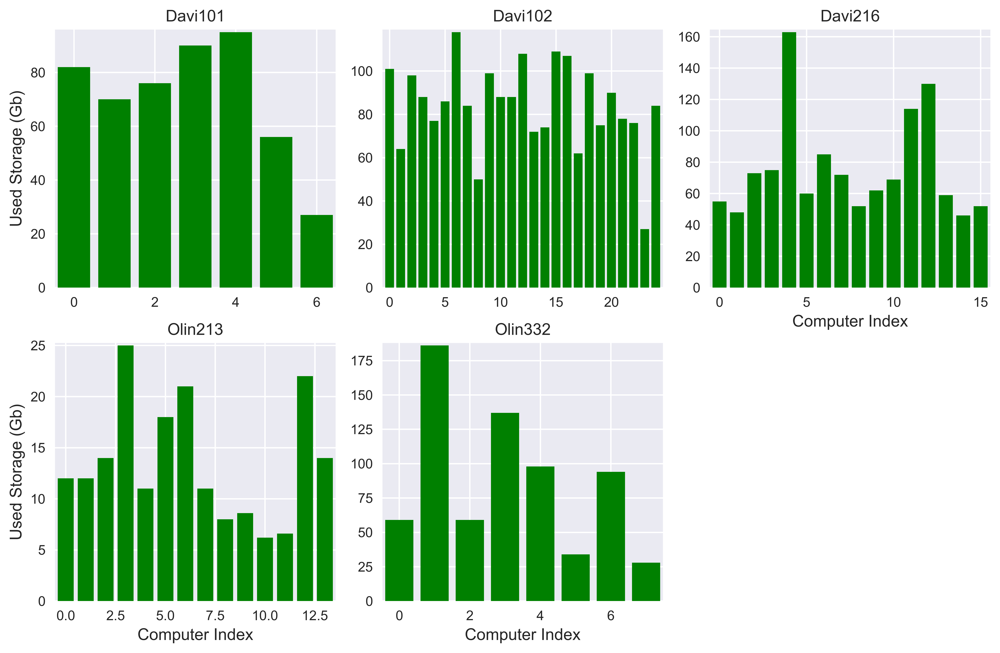

In [5]:
dictt=get_ListOfDataFrames(cuo)
#debug_print(dictt)
llabel=['CCID', 'CPUGen', 'ClockRate','DiskUsed']
#generate multiplot using gidplot
#Plots= tuple(List)
count=0
shape=(11,16)  # this describes the figure grid
loc=[(0,0),(0,5),(0,10),(5,0),(5,5)]
xlocchk=[(5,0),(5,5),(0,10)]
ylocchk=[(0,0),(5,0)]
fig = plt.figure()
for key in dictt.keys():
    df = dictt[key]
    df.columns=llabel
    #fig1,Plots=plt.subplots()
    ind =str(count)
    ax ='ax'+ind
    ax=plt.subplot2grid(shape, loc[count], rowspan=5, colspan=5)
    
    x = df.CCID.index
    y= df.DiskUsed
    title=key
    x_label='Computer Index'
    y_label='Used Storage (Gb)'
    PlotBar(x,y,ax,title,x_label,y_label,loc[count],xlocchk,ylocchk,Label='',Color='green')
    #PlotImpulse(x,y,ax,title,x_label,y_label,loc[count],xlocchk,ylocchk)
    count +=1
fig.set_size_inches(11,7)
fig.tight_layout()
fig.dpi=600


    

# User usage of computers in each classroom
Users are tracked to determine how many accounts they set up in A classroom.  
The total number of computer users per classroom is determined in the process.  
We plot a bar chart of user index against number of accounts and total disk usage   
by a user in a classroom.   


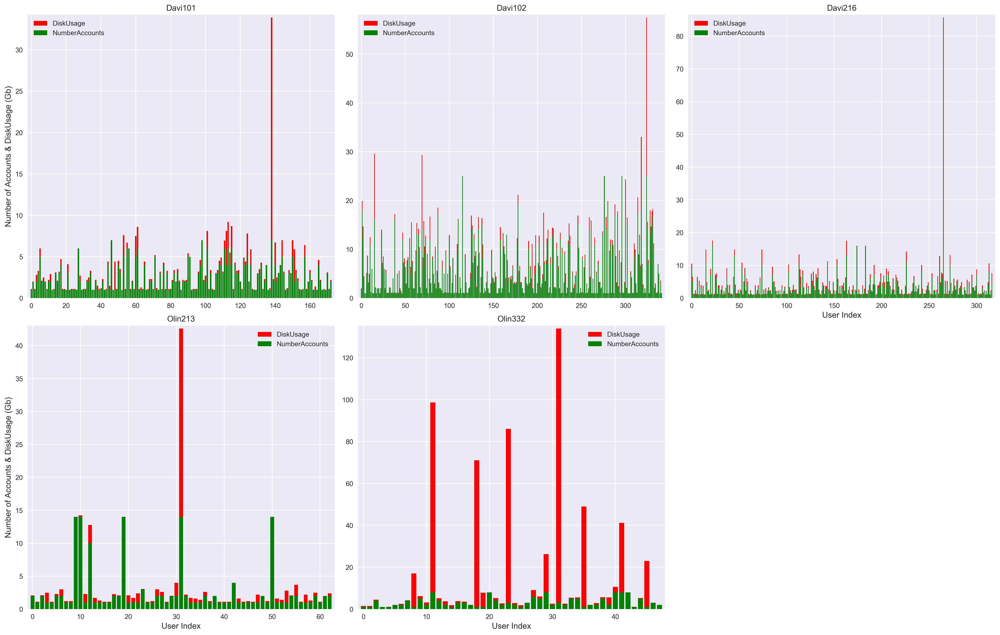

In [6]:
dictt=get_ListOfDataFrames(duo)
#debug_print(dictt)
llabel=['users', 'Counts', 'DiskUsage']
#generate multiplot using gidplot
#Plots= tuple(List)
count=0
shape=(22,32)  # this describes the figure grid
loc=[(0,0),(0,10),(0,20),(10,0),(10,10)]
xlocchk=[(10,0),(10,10),(0,20)]
ylocchk=[(0,0),(10,0)]
fig1 = plt.figure()
for key in dictt.keys():
    df = dictt[key]
    df.columns=llabel
    #fig1,Plots=plt.subplots()
    ind =str(count)
    ax ='ax'+ind
    ax=plt.subplot2grid(shape, loc[count], rowspan=10, colspan=10)
    
    x = df.users.index
    y= df.DiskUsage
    y1= df.Counts
    title=key
    x_label='User Index'
    y_label='Number of Accounts & DiskUsage (Gb)'
    PlotBar(x,y,ax,title,x_label,y_label,loc[count],xlocchk,ylocchk,Label="DiskUsage",Color='red')
    PlotBar(x,y1,ax,title,x_label,y_label,loc[count],xlocchk,ylocchk,Label="NumberAccounts",Color='green')
    #PlotImpulse(x,y,ax,title,x_label,y_label,loc[count],xlocchk,ylocchk)
    count +=1
fig1.set_size_inches(22,14)
fig1.tight_layout()
fig1.dpi=300
fig1.savefig('NaccntDiskUsage.eps', metadata={'Number of Accounts & DiskUsage (Gb)'})

    

# Davis 102 and Davis 216 User Usage .  
These two classrooms show intense activity. So we are going to zoom through the data.

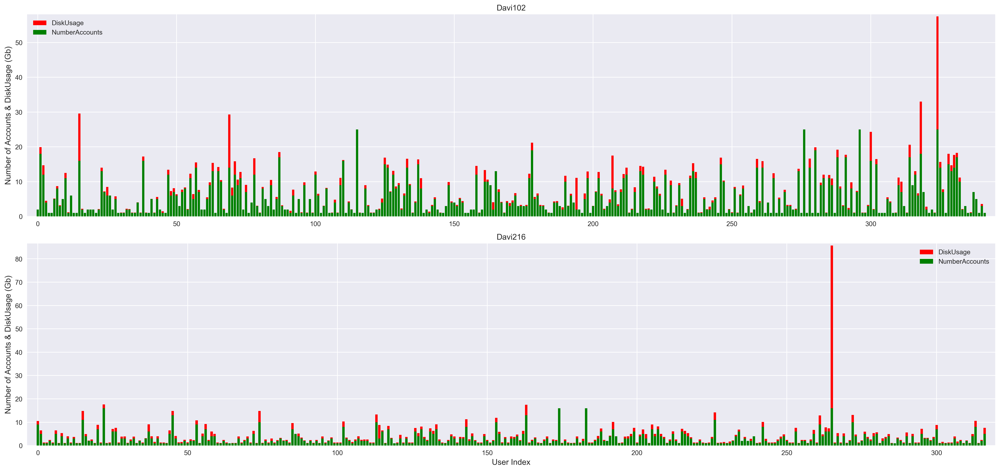

In [7]:
dictt=get_ListOfDataFrames(duo)
#debug_print(dictt)
llabel=['users', 'Counts', 'DiskUsage']
#generate multiplot using gidplot
#Plots= tuple(List)
count=0
shape=(21,10)  # this describes the figure grid
loc=[(0,0),(10,0)]
xlocchk=[(10,0)]
ylocchk=[(0,0),(10,0)]
fig26 = plt.figure()
Sclass=['Davi102','Davi216']
for key in Sclass:
    df = dictt[key]
    df.columns=llabel
    #fig1,Plots=plt.subplots()
    ind =str(count)
    ax ='ax'+ind
    ax=plt.subplot2grid(shape, loc[count], rowspan=10, colspan=10)
    
    x = df.users.index
    y= df.DiskUsage
    y1= df.Counts
    title=key
    x_label='User Index'
    y_label='Number of Accounts & DiskUsage (Gb)'
    PlotBar(x,y,ax,title,x_label,y_label,loc[count],xlocchk,ylocchk,Label="DiskUsage",Color='red')
    PlotBar(x,y1,ax,title,x_label,y_label,loc[count],xlocchk,ylocchk,Label="NumberAccounts",Color='green')
    count +=1
fig26.set_size_inches(21,10)
fig26.tight_layout()
fig26.dpi=300
fig26.savefig('Davis102-Davis216DiskUsage.eps', metadata={'Davis102 & Davis216 DiskUsage in (Gb)'})

    

# Computer load balancing at Login.       
We will look at the computer load from  login after idle, and restarting   
This will be done using both active directory and local accounts.           


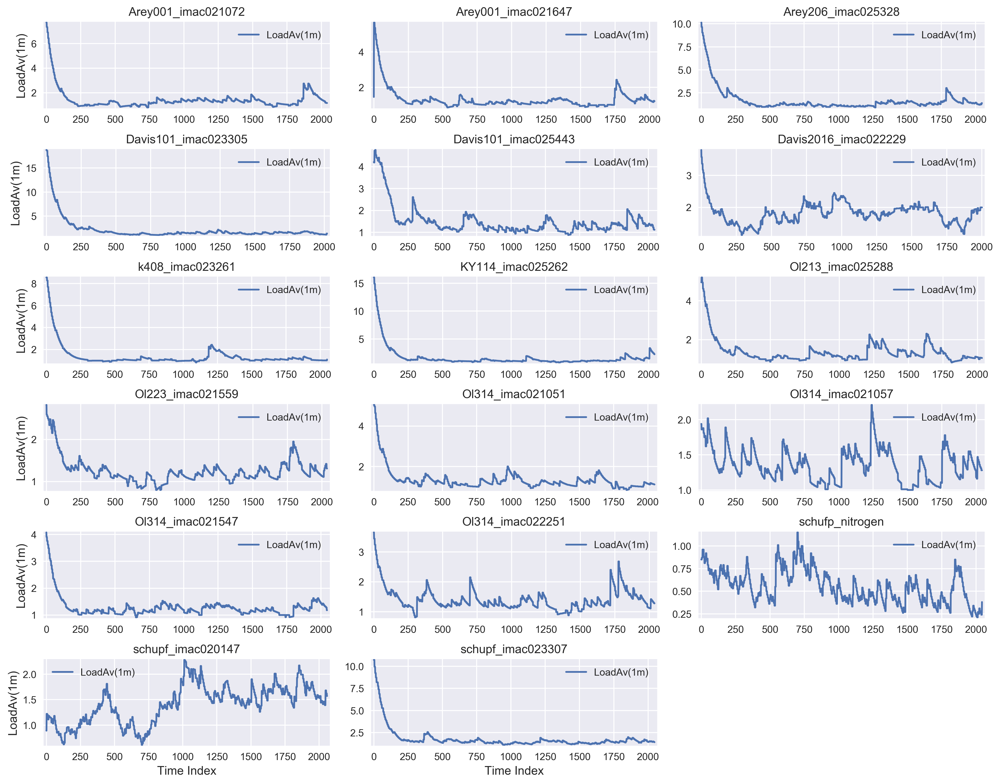

In [8]:
#Load balancing at login
dictt=get_ListOfDataFrames(LoAvLog)
#debug_print(dictt)
llabel=[ "Time", "LoadAv(1m)", "LoadAv(5m)", "LoadAv(15m)" ]
#generate multiplot using gidplot
#Plots= tuple(List)
count=0
loc=[]
xlocchk=[]
ylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,60,30,10,10
shape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        loc.append((i,j))

#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    ylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    xlocchk.append((rmax-rrange,jjy))        

figl = plt.figure()
genplot(dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
figl.set_size_inches(14,11)
figl.tight_layout()
figl.dpi=300

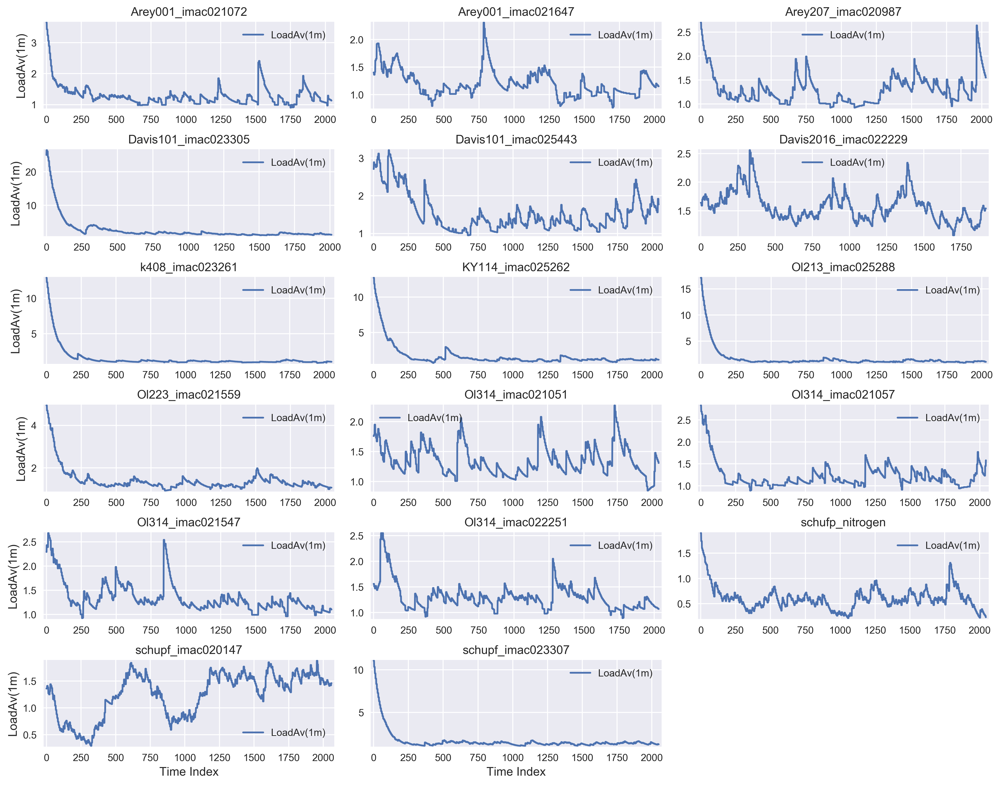

In [9]:
#Load balancing at Start
dictt=get_ListOfDataFrames(LoAvStart)
    
figs = plt.figure()  #Call this before function below
genplot(dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
#genplot(dictt,llabel,0,2,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
#genplot(dictt,llabel,0,3,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
figs.set_size_inches(14,11)
figs.tight_layout()
figs.dpi=300

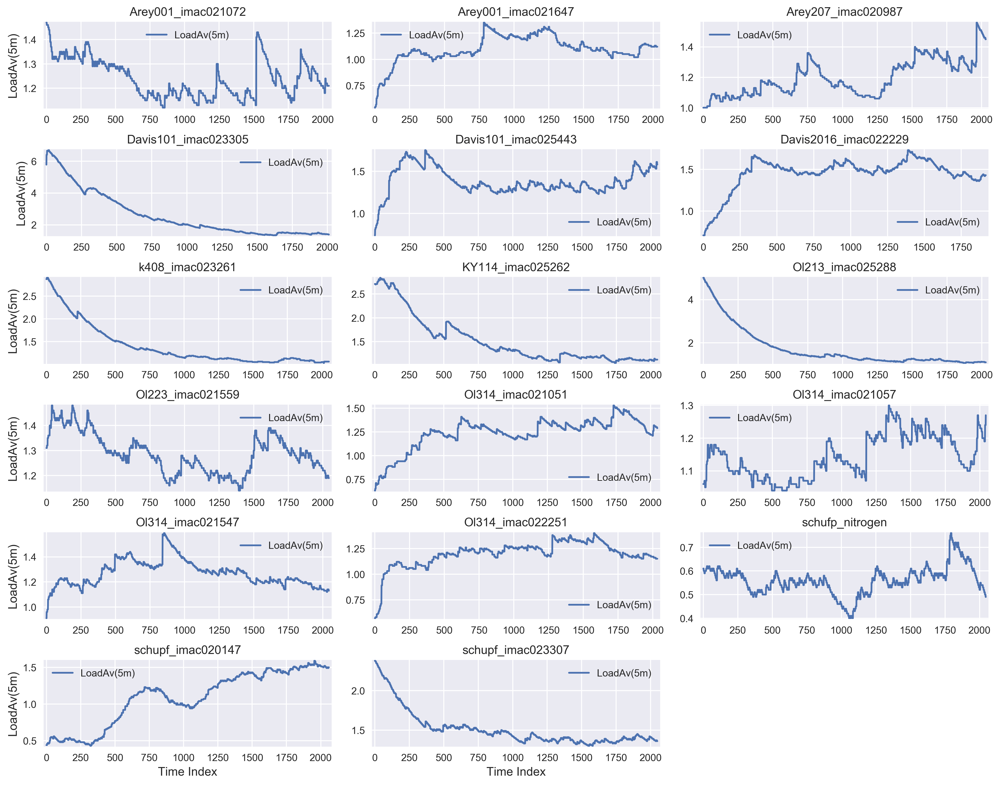

In [10]:
figs = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
genplot(dictt,llabel,0,2,'Time Index','LoadAv(5m)',rrange,crange,shape,loc,xlocchk,ylocchk)
#genplot(dictt,llabel,0,3,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
figs.set_size_inches(14,11)
figs.tight_layout()
figs.dpi=300

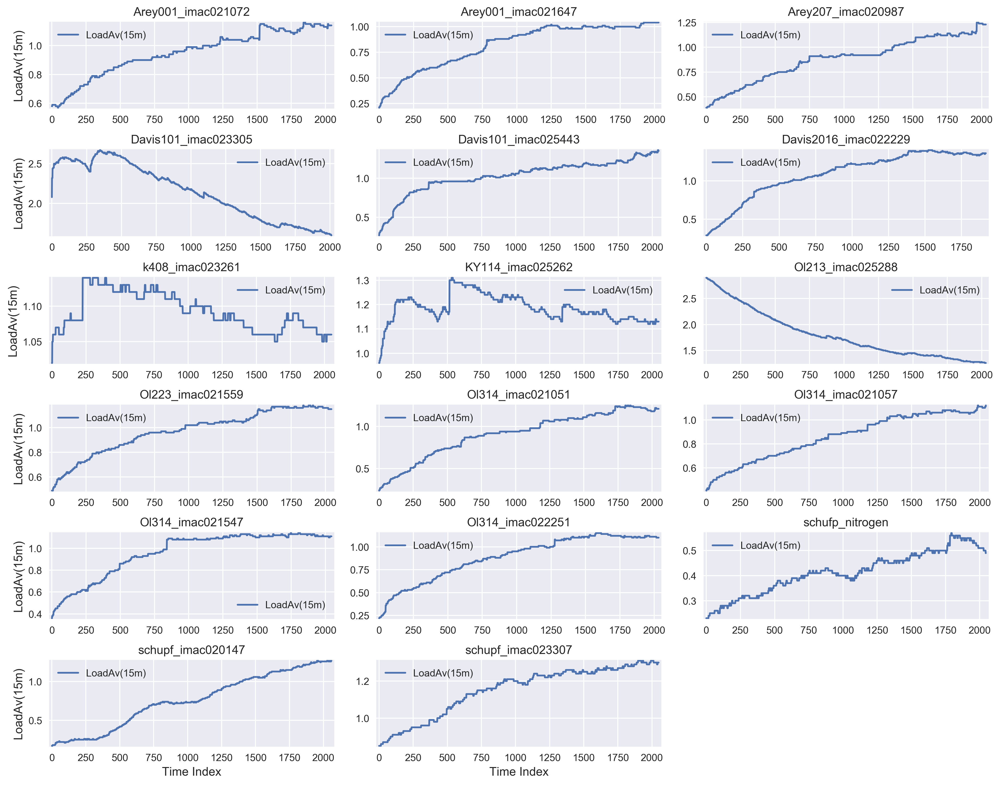

In [11]:
figs = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
#genplot(dictt,llabel,0,2,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
genplot(dictt,llabel,0,3,'Time Index','LoadAv(15m)',rrange,crange,shape,loc,xlocchk,ylocchk)
figs.set_size_inches(14,11)
figs.tight_layout()
figs.dpi=300

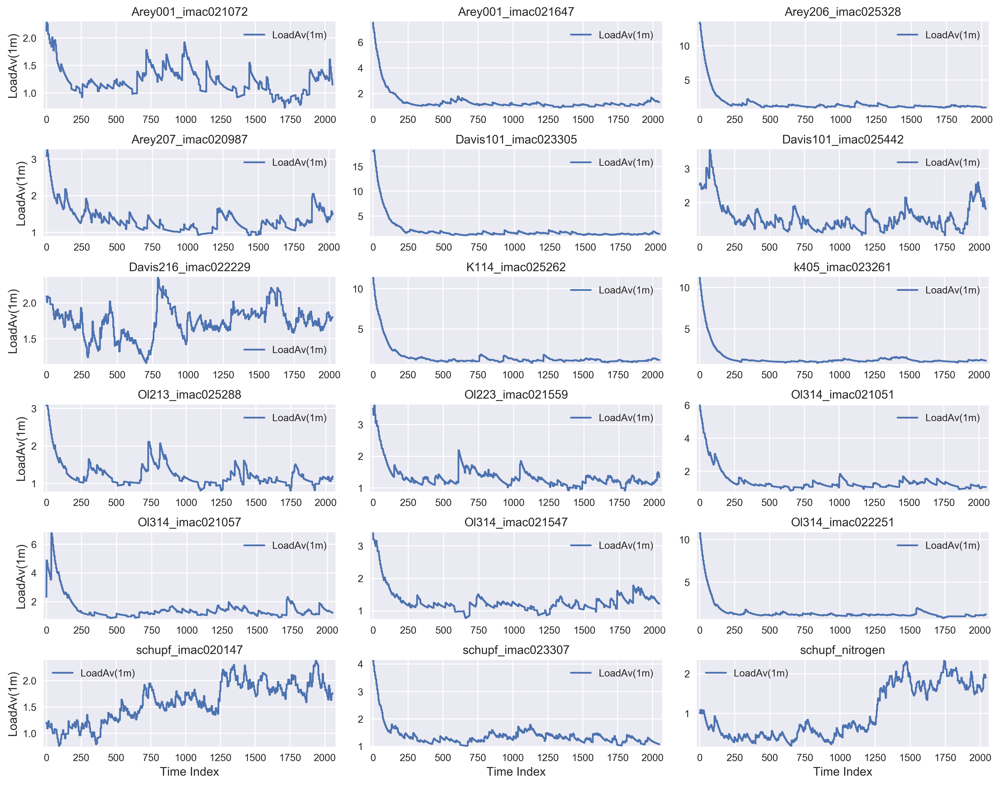

In [12]:
#Load balancing at login from DSN
dictt=get_ListOfDataFrames(LoAvLogDNS)
figld = plt.figure()  #Call this before function below
genplot(dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
#genplot(dictt,llabel,0,2,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
#genplot(dictt,llabel,0,3,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)

figld.set_size_inches(14,11)
figld.tight_layout()
figld.dpi=300

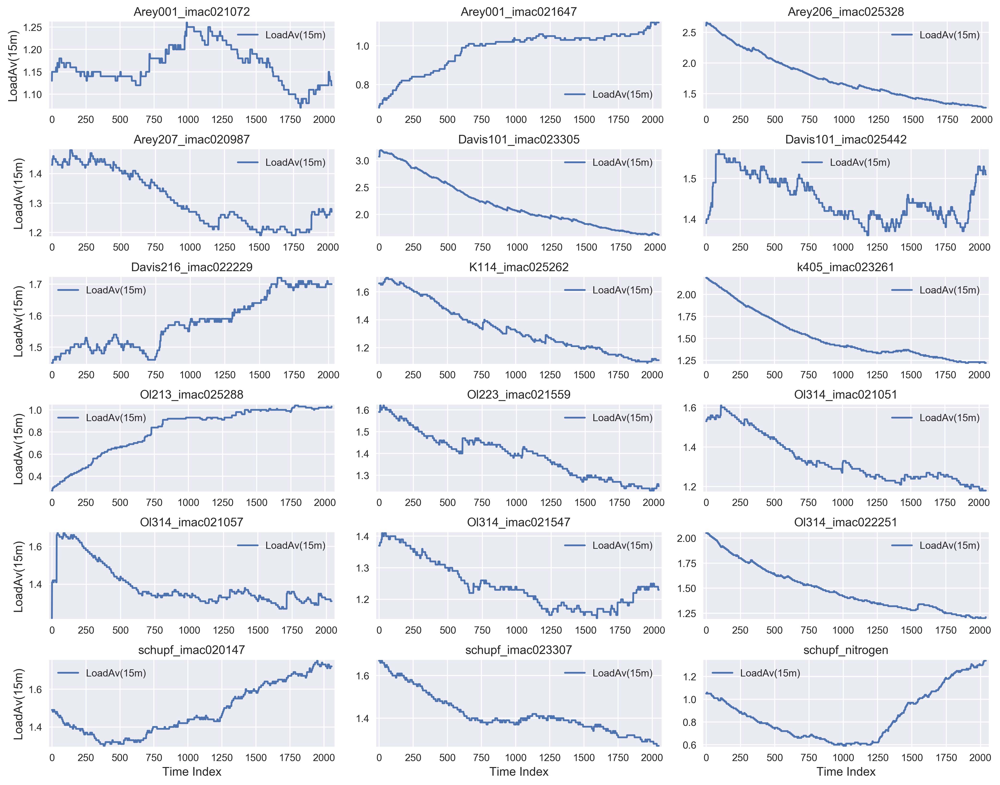

In [13]:
figs = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
#genplot(dictt,llabel,0,2,'Time Index','LoadAv(1m)',rrange,crange,shape,loc,xlocchk,ylocchk)
genplot(dictt,llabel,0,3,'Time Index','LoadAv(15m)',rrange,crange,shape,loc,xlocchk,ylocchk)
figs.set_size_inches(14,11)
figs.tight_layout()
figs.dpi=300

# Memory Usage at Login.       
We will look at memory usage from  login after idle, and restarting   
This will be done using both active directory and local accounts.           


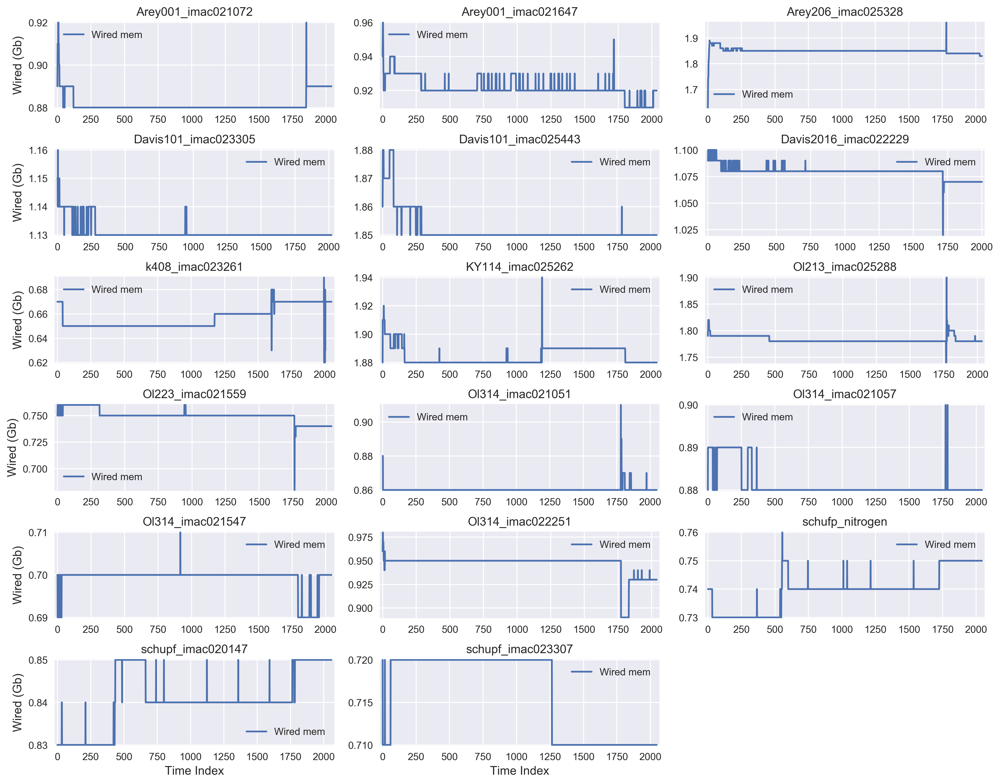

In [14]:
#Memory usage at login

dictt=get_ListOfDataFrames(PhMemLog)
#debug_print(dictt)
llabel=[ "Time", "Used mem", "Wired mem", "Unused mem" ]
#generate multiplot using gidplot
#Plots= tuple(List)

loc=[]
xlocchk=[]
ylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,60,30,10,10
shape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        loc.append((i,j))
                
#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    ylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    xlocchk.append((rmax-rrange,jjy))
#print(xlocchk)   

    
figml = plt.figure()  #Call this before function below
genplot(dictt,llabel,0,2,'Time Index','Wired (Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #wired
#genplot(dictt,llabel,0,3,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Unused
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figml.set_size_inches(14,11)
figml.tight_layout()
figml.dpi=300

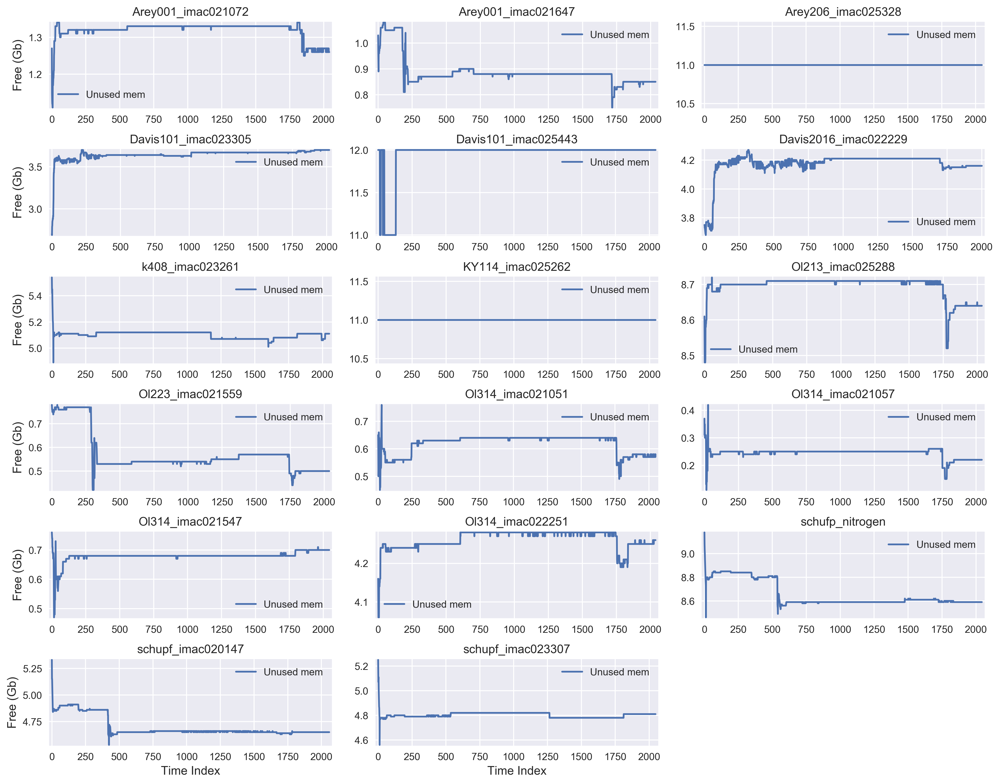

In [15]:
figml = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #wired
genplot(dictt,llabel,0,3,'Time Index','Free (Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Unused
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figml.set_size_inches(14,11)
figml.tight_layout()
figml.dpi=300

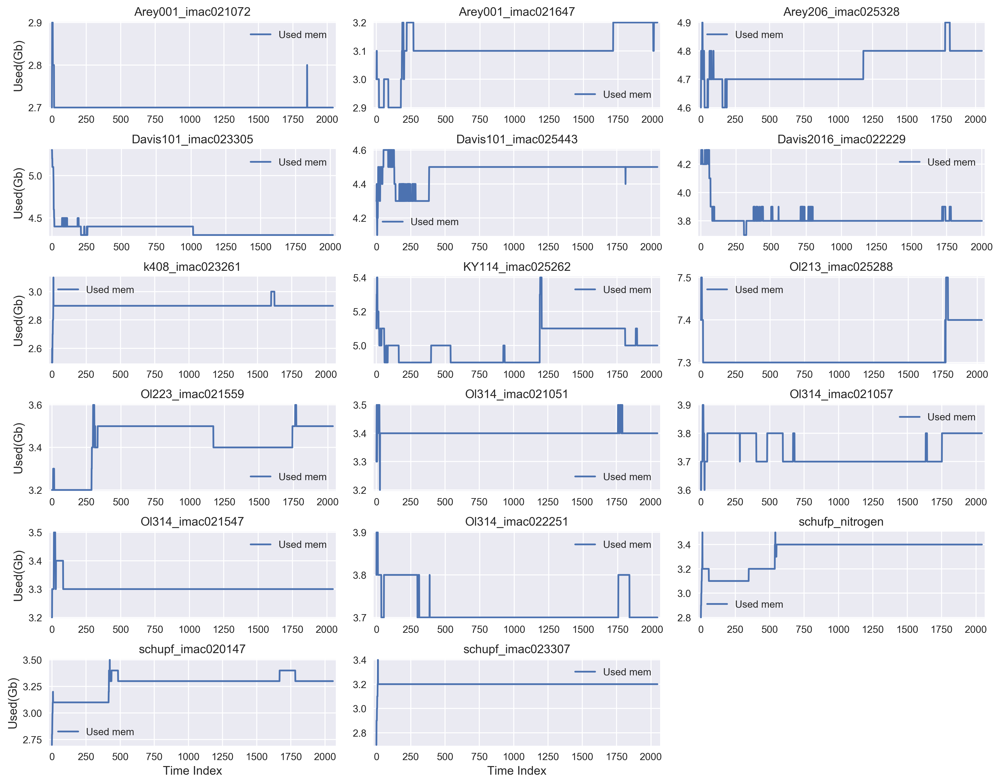

In [16]:
figml = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #wired
#genplot(dictt,llabel,0,3,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Unused
genplot(dictt,llabel,0,1,'Time Index','Used(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figml.set_size_inches(14,11)
figml.tight_layout()
figml.dpi=300

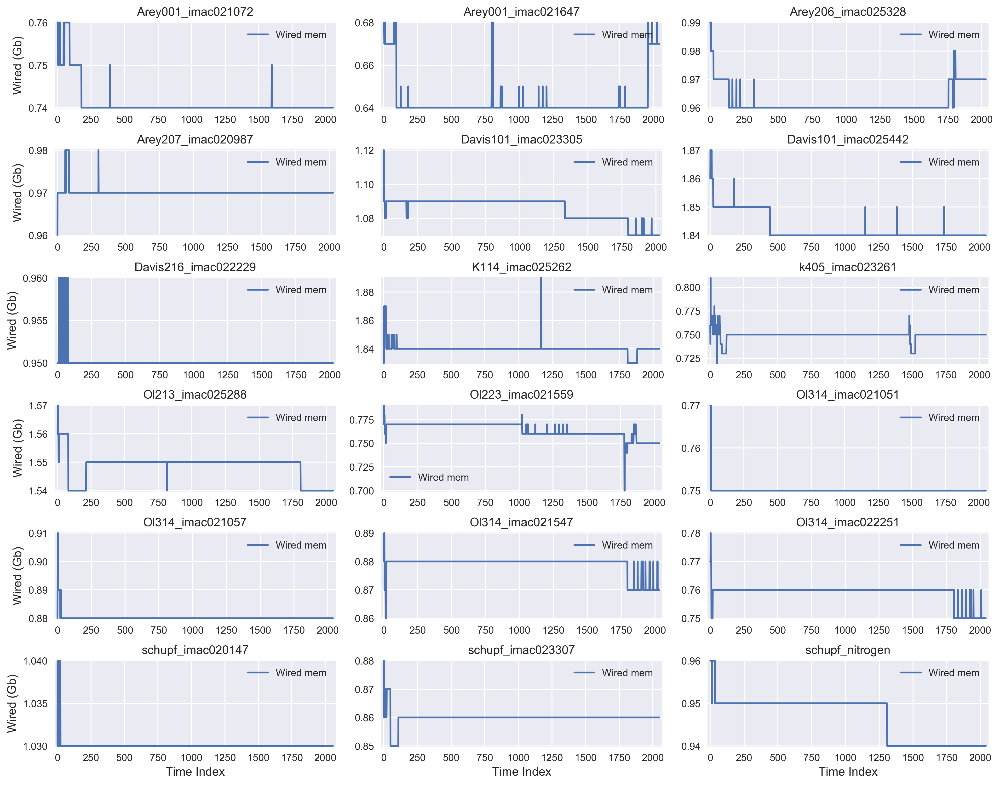

In [17]:
#Memory usage at login on DNS

dictt=get_ListOfDataFrames(PhMemLogDNS)
#debug_print(dictt)
llabel=[ "Time", "Used mem", "Wired mem", "Unused mem" ]
#generate multiplot using gidplot
#Plots= tuple(List)

loc=[]
xlocchk=[]
ylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,60,30,10,10
shape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        loc.append((i,j))
                
#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    ylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    xlocchk.append((rmax-rrange,jjy))
#print(xlocchk)   

    
figml = plt.figure()  #Call this before function below
genplot(dictt,llabel,0,2,'Time Index','Wired (Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #wired
#genplot(dictt,llabel,0,3,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Unused
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figml.set_size_inches(14,11)
figml.set_size_inches(14,11)
figml.tight_layout()
figml.dpi=300

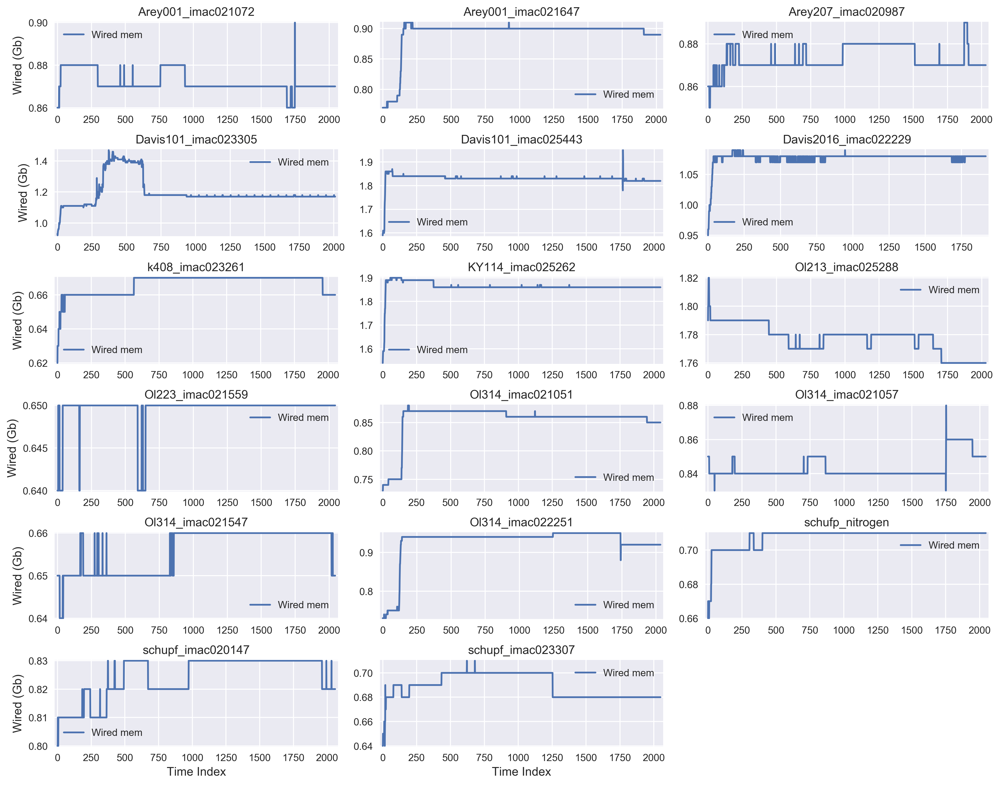

In [18]:
#Memory usage at restart

dictt=get_ListOfDataFrames(PhMemStart)
#debug_print(dictt)
llabel=[ "Time", "Used mem", "Wired mem", "Unused mem" ]
#generate multiplot using gidplot
#Plots= tuple(List)

loc=[]
xlocchk=[]
ylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,60,30,10,10
shape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        loc.append((i,j))
                
#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    ylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    xlocchk.append((rmax-rrange,jjy))
#print(xlocchk)   

    
figms = plt.figure()  #Call this before function below
genplot(dictt,llabel,0,2,'Time Index','Wired (Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #wired
#genplot(dictt,llabel,0,3,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Unused
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figms.set_size_inches(14,11)
figms.set_size_inches(14,11)
figms.tight_layout()
figms.dpi=300

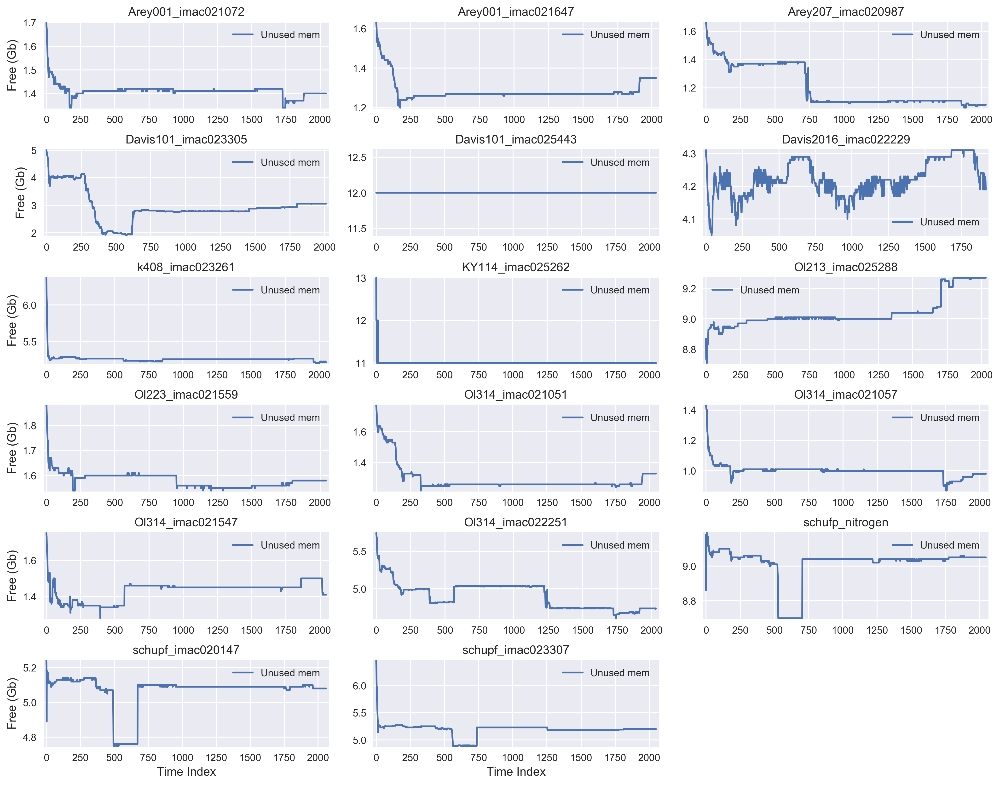

In [19]:
figms = plt.figure()
genplot(dictt,llabel,0,3,'Time Index','Free (Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Unused
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figms.set_size_inches(14,11)
figms.tight_layout()
figms.dpi=300

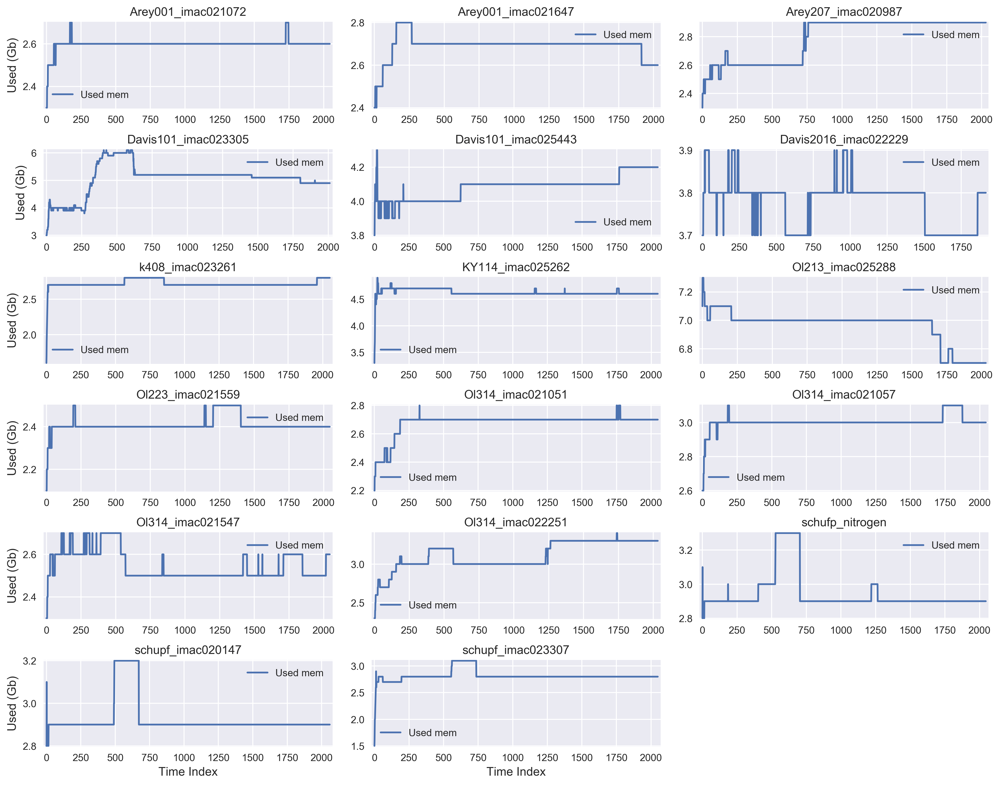

In [20]:
figms = plt.figure()
#genplot(dictt,llabel,0,3,'Time Index','free (Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Unused
genplot(dictt,llabel,0,1,'Time Index','Used (Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figms.set_size_inches(14,11)
figms.set_size_inches(14,11)
figms.tight_layout()
figms.dpi=300

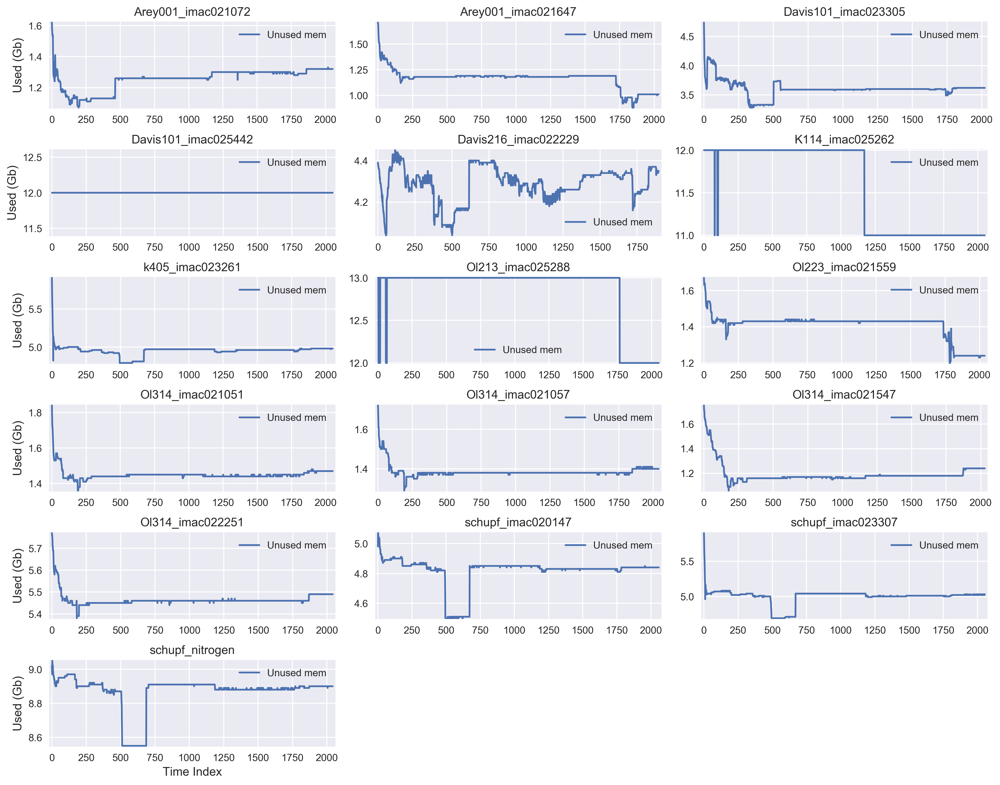

In [21]:
#Memory usage at restart with DNS account

dictt=get_ListOfDataFrames(PhMemStartDNS)
#debug_print(dictt)
llabel=[ "Time", "Used mem", "Wired mem", "Unused mem" ]
#generate multiplot using gidplot
#Plots= tuple(List)

loc=[]
xlocchk=[]
ylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,60,30,10,10
shape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        loc.append((i,j))
                
#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    ylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    xlocchk.append((rmax-rrange,jjy))
#print(xlocchk)   

    
figmsd = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,2,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #wired
genplot(dictt,llabel,0,3,'Time Index','Used (Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Unused
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figmsd.set_size_inches(14,11)
figmsd.set_size_inches(14,11)
figmsd.tight_layout()
figmsd.dpi=300

# Processes and Threads at Login.¶
We will look at processes and thread counts from login after idle, and restarting
This will be done using both active directory and local accounts.

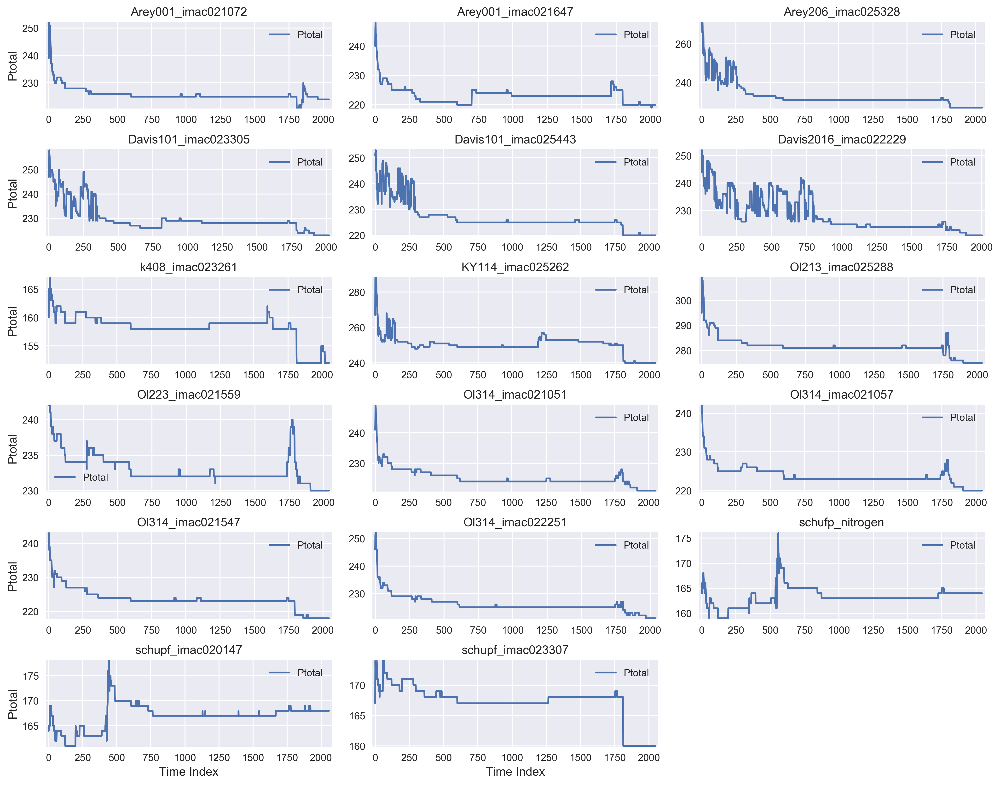

In [22]:
#Processes and threads at login

dictt=get_ListOfDataFrames(ProcsLog)
#debug_print(dictt)
llabel=[ "Time", "Ptotal", "running", "stuck", "sleeping", "nthread"]
#generate multiplot using gidplot
#Plots= tuple(List)

loc=[]
xlocchk=[]
ylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,60,30,10,10
shape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        loc.append((i,j))
                
#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    ylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    xlocchk.append((rmax-rrange,jjy))
#print(xlocchk)       
figmpl = plt.figure()  #Call this before function below
genplot(dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,shape,loc,xlocchk,ylocchk) #Ptotal
figmpl.set_size_inches(14,11)
figmpl.set_size_inches(14,11)
figmpl.tight_layout()
figmpl.dpi=300

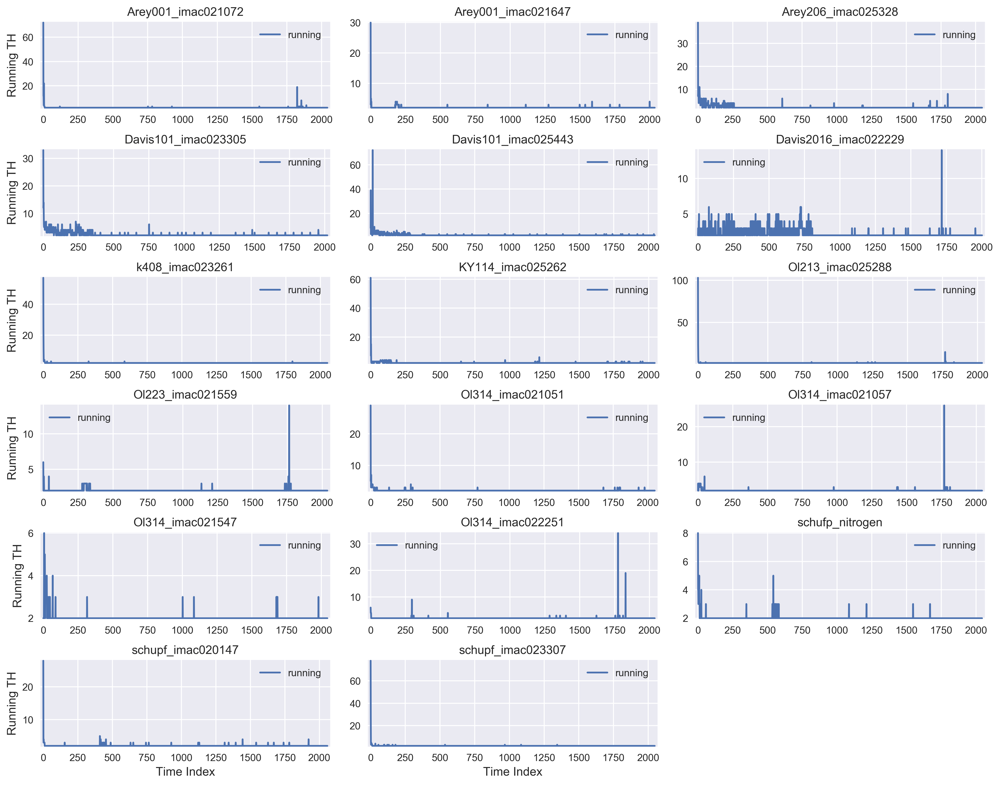

In [23]:
figmpl = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #ptotal
genplot(dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,shape,loc,xlocchk,ylocchk)  #running
#genplot(dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,shape,loc,xlocchk,ylocchk)  #stuck
#genplot(dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,shape,loc,xlocchk,ylocchk)  #sleeping
#genplot(dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,shape,loc,xlocchk,ylocchk)  #sleeping
figmpl.set_size_inches(14,11)
figmpl.set_size_inches(14,11)
figmpl.tight_layout()
figmpl.dpi=300

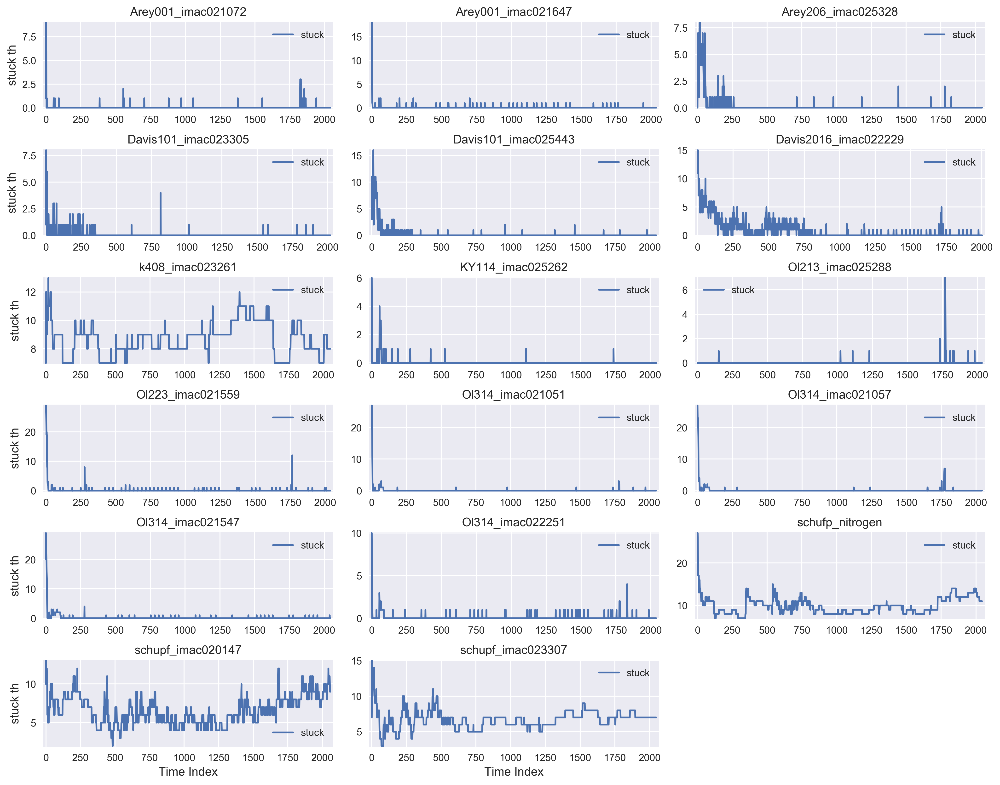

In [24]:
figmpl = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,shape,loc,xlocchk,ylocchk) #ptotal
#genplot(dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,shape,loc,xlocchk,ylocchk)  #running
genplot(dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,shape,loc,xlocchk,ylocchk)  #stuck
#genplot(dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,shape,loc,xlocchk,ylocchk)  #sleeping
#genplot(dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,shape,loc,xlocchk,ylocchk)  #sleeping
figmpl.set_size_inches(14,11)
figmpl.set_size_inches(14,11)
figmpl.tight_layout()
figmpl.dpi=300

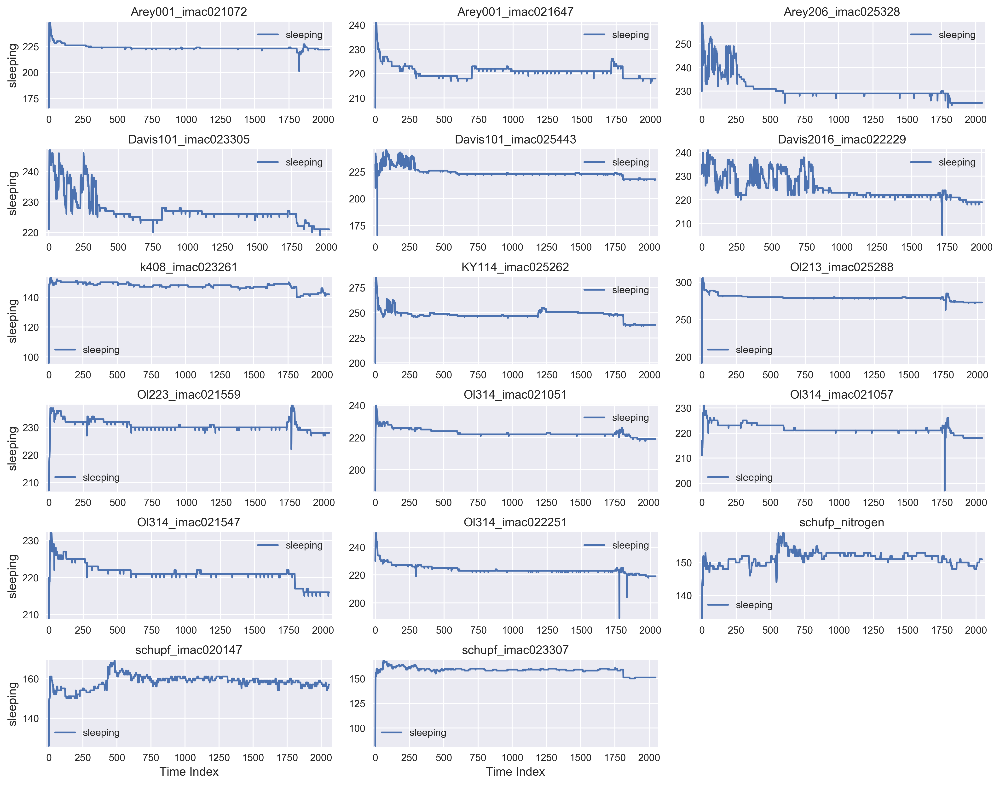

In [25]:
figmpl = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #ptotal
#genplot(dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,shape,loc,xlocchk,ylocchk)  #running
#genplot(dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,shape,loc,xlocchk,ylocchk)  #stuck
genplot(dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,shape,loc,xlocchk,ylocchk)  #sleeping
#genplot(dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,shape,loc,xlocchk,ylocchk)  #sleeping
figmpl.set_size_inches(14,11)
figmpl.set_size_inches(14,11)
figmpl.tight_layout()
figmpl.dpi=300

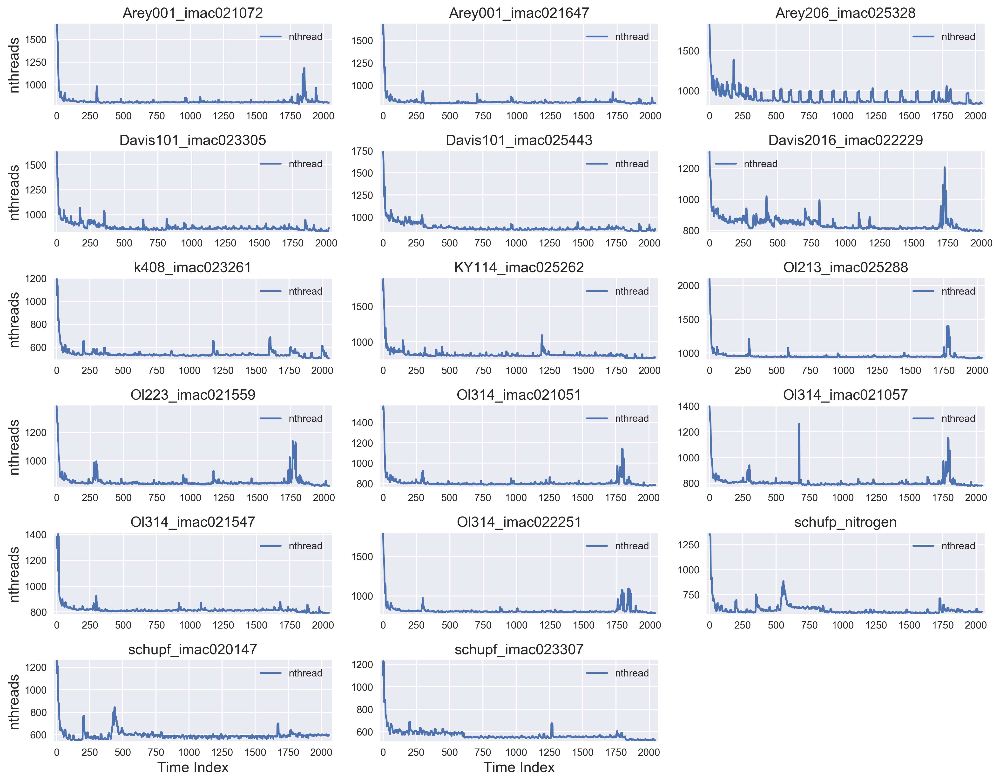

In [72]:
figmpl = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #ptotal
#genplot(dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,shape,loc,xlocchk,ylocchk)  #running
#genplot(dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,shape,loc,xlocchk,ylocchk)  #stuck
#genplot(dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,shape,loc,xlocchk,ylocchk)  #sleeping
genplot(dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,shape,loc,xlocchk,ylocchk)  #sleeping
figmpl.set_size_inches(14,11)
figmpl.tight_layout()
figmpl.dpi=300

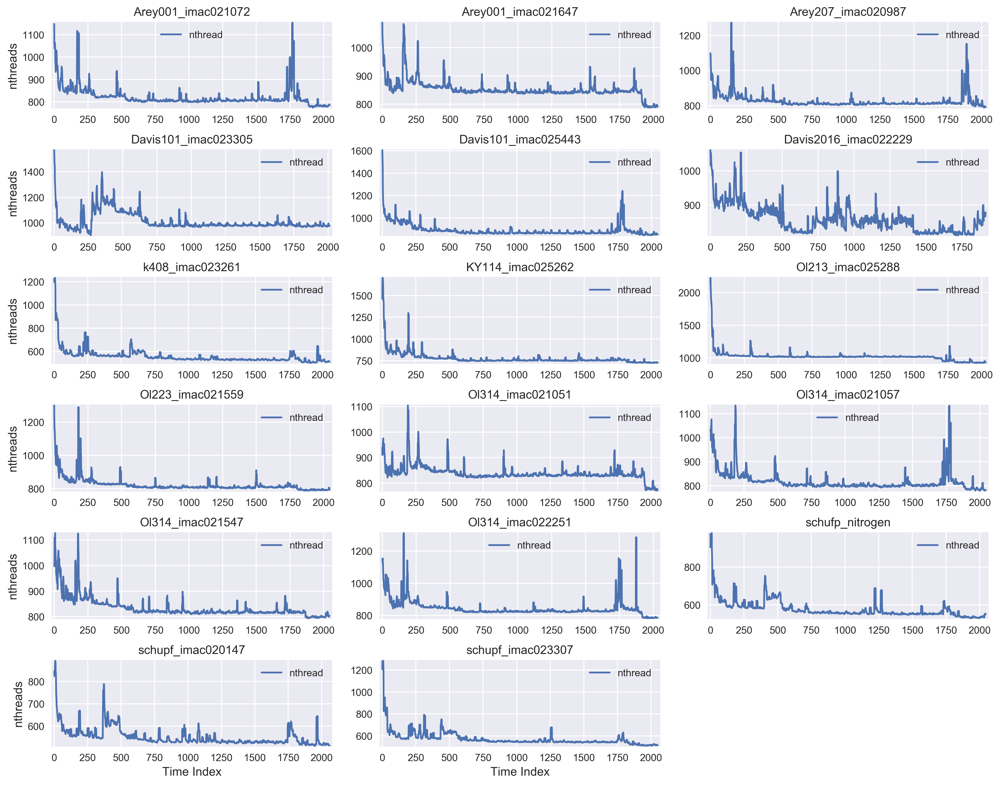

In [26]:
#Processes and threads at restart

dictt=get_ListOfDataFrames(ProcsStart)
#debug_print(dictt)
llabel=[ "Time", "Ptotal", "running", "stuck", "sleeping", "nthread"]
#generate multiplot using gidplot
#Plots= tuple(List)

loc=[]
xlocchk=[]
ylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,60,30,10,10
shape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        loc.append((i,j))
                
#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    ylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    xlocchk.append((rmax-rrange,jjy))
#print(xlocchk)   

    
figms = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,2,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #wired
genplot(dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,shape,loc,xlocchk,ylocchk)  #Total Threads
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figms.set_size_inches(14,11)
figms.set_size_inches(14,11)
figms.tight_layout()
figms.dpi=300

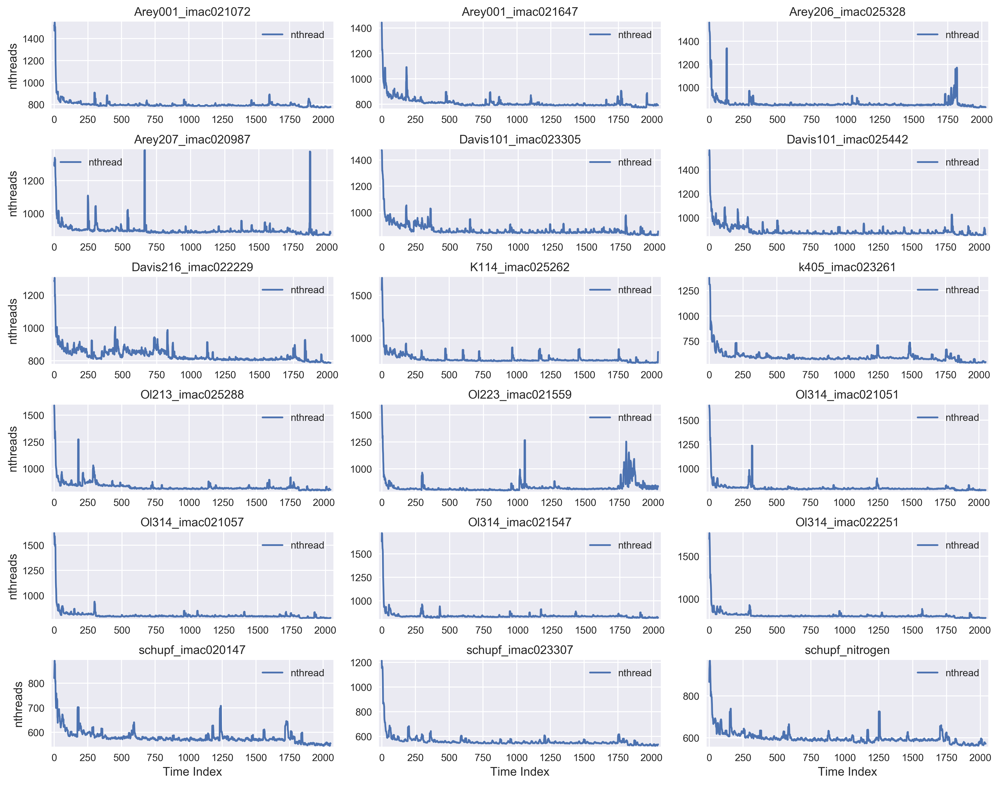

In [27]:
#Processes and threads at login with DNS

dictt=get_ListOfDataFrames(ProcsLogDNS)
#debug_print(dictt)
llabel=[ "Time", "Ptotal", "running", "stuck", "sleeping", "nthread"]
#generate multiplot using gidplot
#Plots= tuple(List)

loc=[]
xlocchk=[]
ylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,60,30,10,10
shape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        loc.append((i,j))
                
#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    ylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    xlocchk.append((rmax-rrange,jjy))
#print(xlocchk)   

    
figms = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,2,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #wired
genplot(dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,shape,loc,xlocchk,ylocchk)  #Total Threads
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figms.set_size_inches(14,11)
figms.set_size_inches(14,11)
figms.tight_layout()
figms.dpi=300

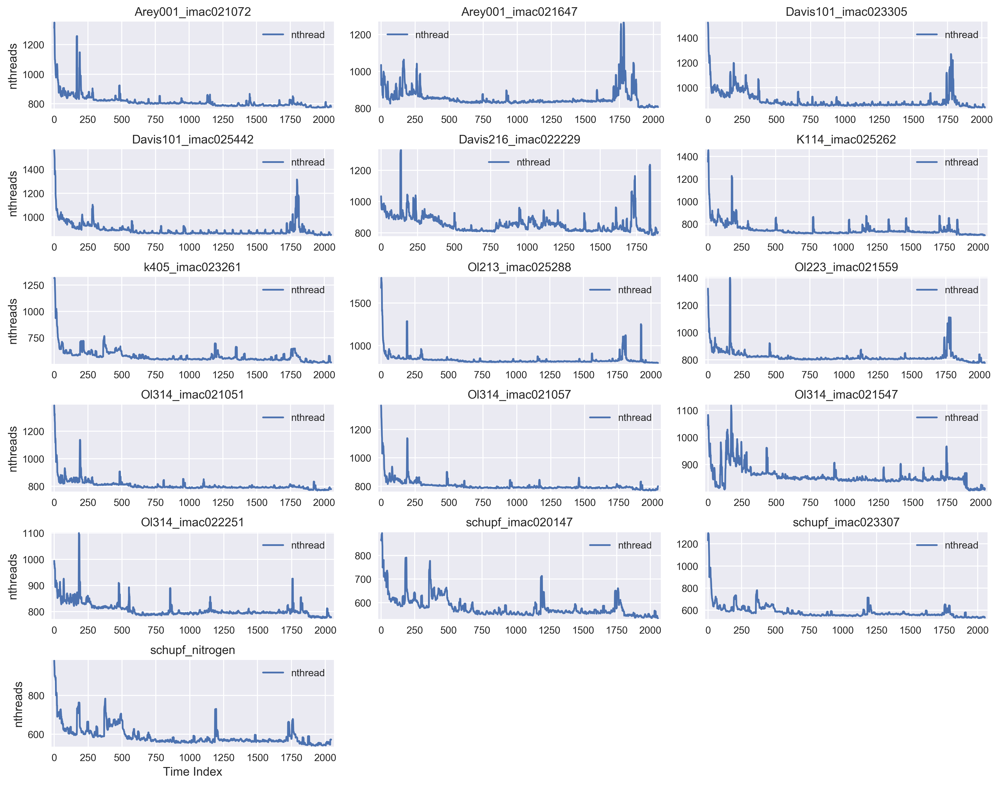

In [28]:
#Processes and threads at restart with DNS

dictt=get_ListOfDataFrames(ProcsStartDNS)
#debug_print(dictt)
llabel=[ "Time", "Ptotal", "running", "stuck", "sleeping", "nthread"]
#generate multiplot using gidplot
#Plots= tuple(List)

loc=[]
xlocchk=[]
ylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,60,30,10,10
shape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        loc.append((i,j))
                
#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    ylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    xlocchk.append((rmax-rrange,jjy))
#print(xlocchk)   

    
figms = plt.figure()  #Call this before function below
#genplot(dictt,llabel,0,2,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk) #wired
genplot(dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,shape,loc,xlocchk,ylocchk)  #Total threads
#genplot(dictt,llabel,0,1,'Time Index','Mem(Gb)',rrange,crange,shape,loc,xlocchk,ylocchk)  #Used
figms.set_size_inches(14,11)
figms.set_size_inches(14,11)
figms.tight_layout()
figms.dpi=300

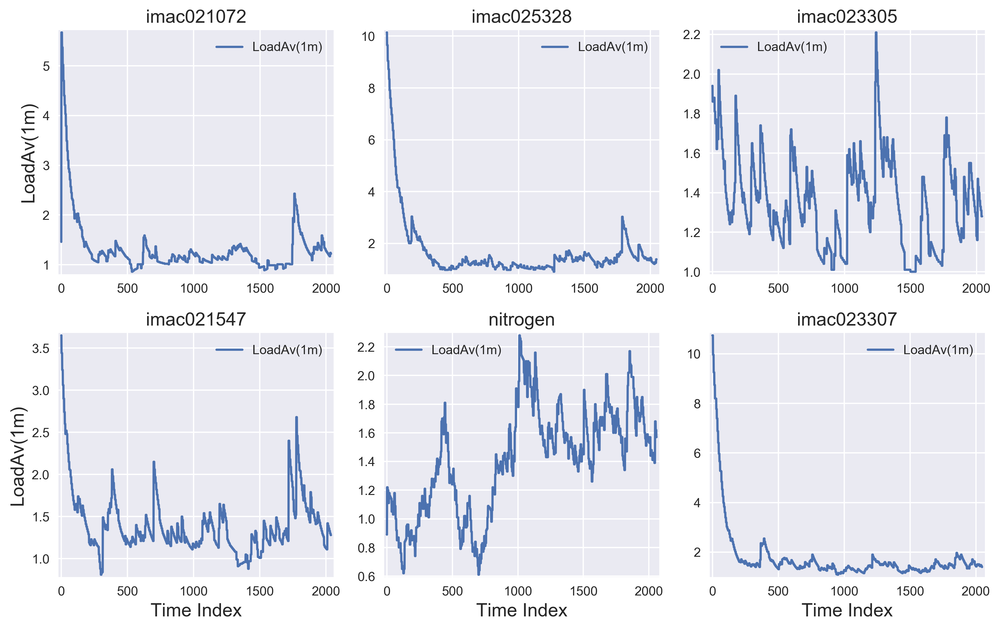

In [76]:
#Load balancing at login
Dictt=get_ListOfDataFrameSift(LoAvLog)
#debug_print(dictt)
llabel=[ "Time", "LoadAv(1m)", "LoadAv(5m)", "LoadAv(15m)" ]
#generate multiplot using gidplot
#Plots= tuple(List)
count=0
sloc=[]
sxlocchk=[]
sylocchk=[]
rmin,cmin,rmax,cmax,rrange,crange = 0,0,20,30,10,10
sshape=(rmax,cmax)  # this describes the figure grid
for i in range(rmin,rmax,rrange):
    for j in range(cmin,cmax,crange):
        sloc.append((i,j))

#on the line x=cmin row changes
for iix in range(rmin,rmax,rrange):
    sylocchk.append((iix,cmin))
#on line y=rmax column varies
for jjy in range(cmin,cmax,crange):
    sxlocchk.append((rmax-rrange,jjy)) 

figs = plt.figure()
genplot(Dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

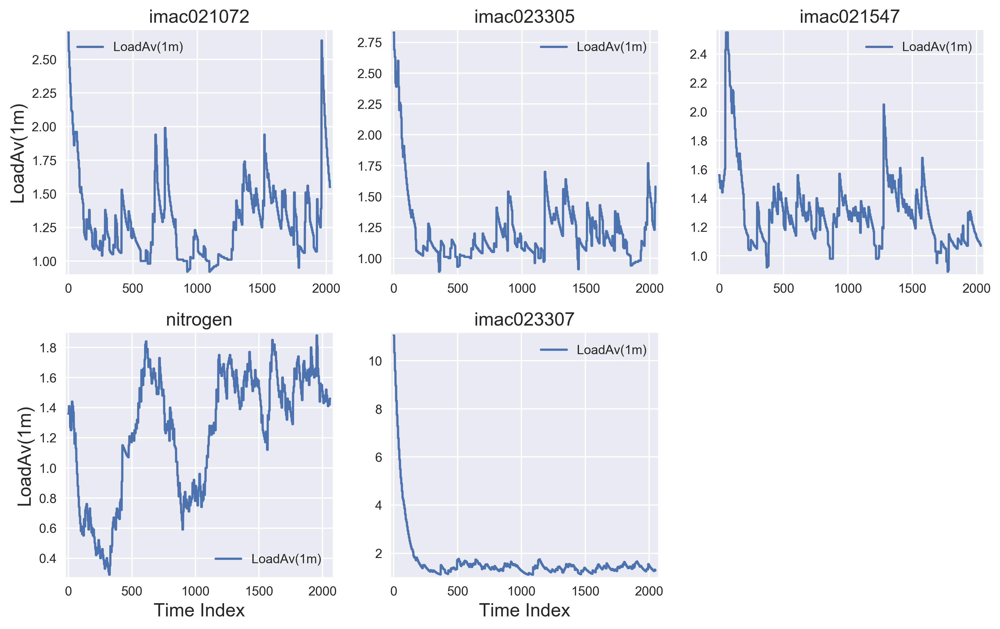

In [77]:
Dictt=get_ListOfDataFrameSift(LoAvStart)
figs = plt.figure()
genplot(Dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

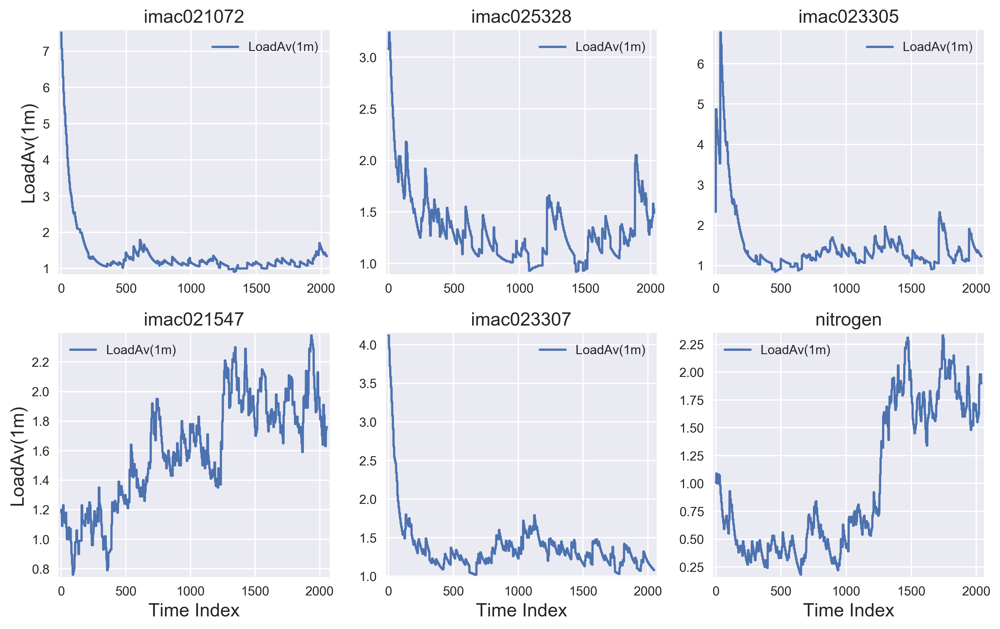

In [78]:
Dictt=get_ListOfDataFrameSift(LoAvLogDNS)
figs = plt.figure()
genplot(Dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

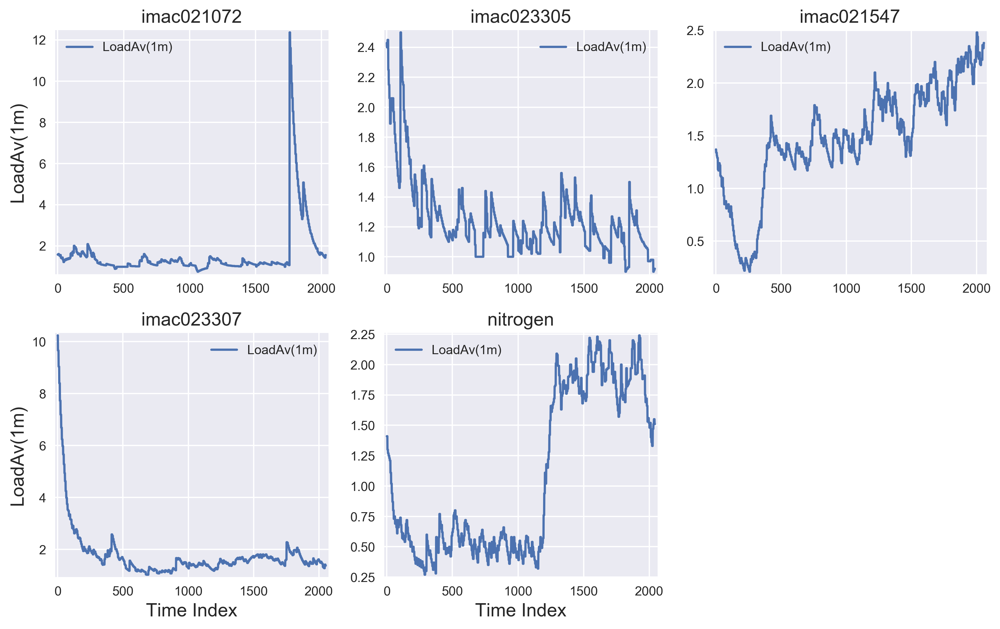

In [79]:
Dictt=get_ListOfDataFrameSift(LoAvStartDNS)
figs = plt.figure()
genplot(Dictt,llabel,0,1,'Time Index','LoadAv(1m)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

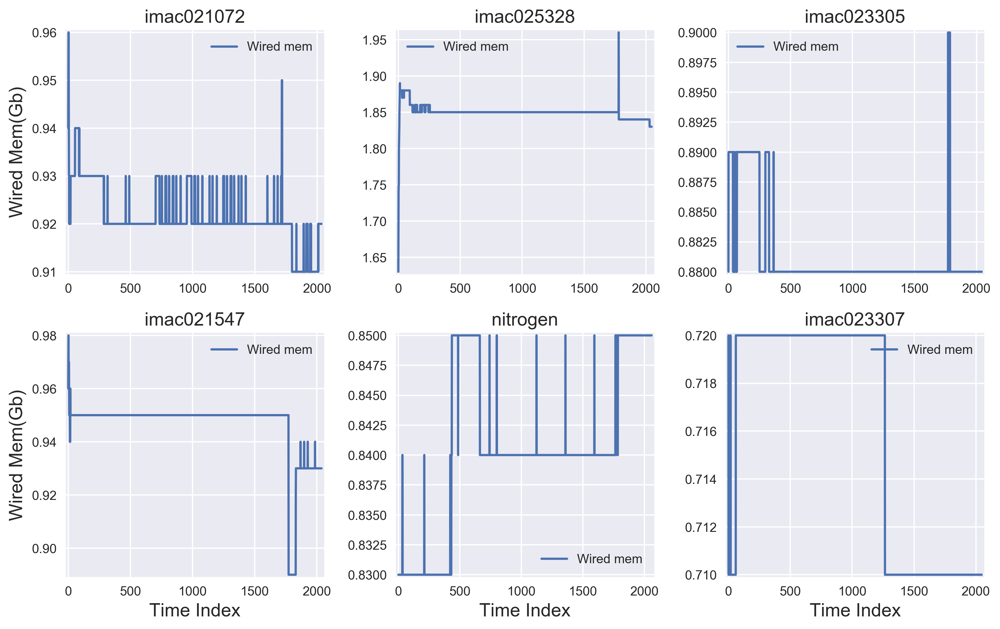

In [82]:
Dictt=get_ListOfDataFrameSift(PhMemLog)
llabel=[ "Time", "Used mem", "Wired mem", "Unused mem" ]
figs = plt.figure()
genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
#genplot(dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
#genplot(dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

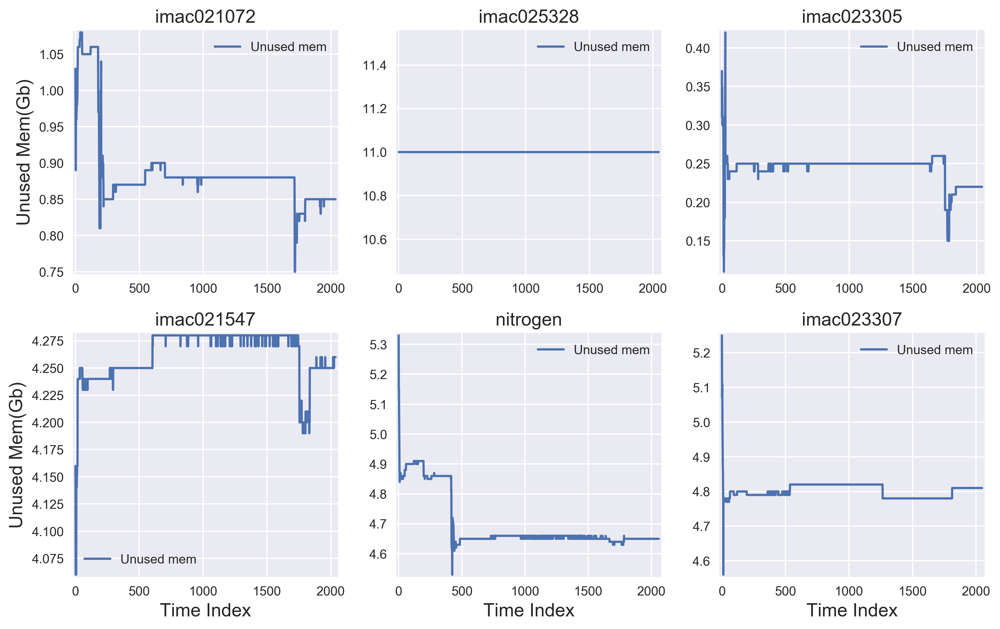

In [83]:
figs = plt.figure()
#genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
#genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

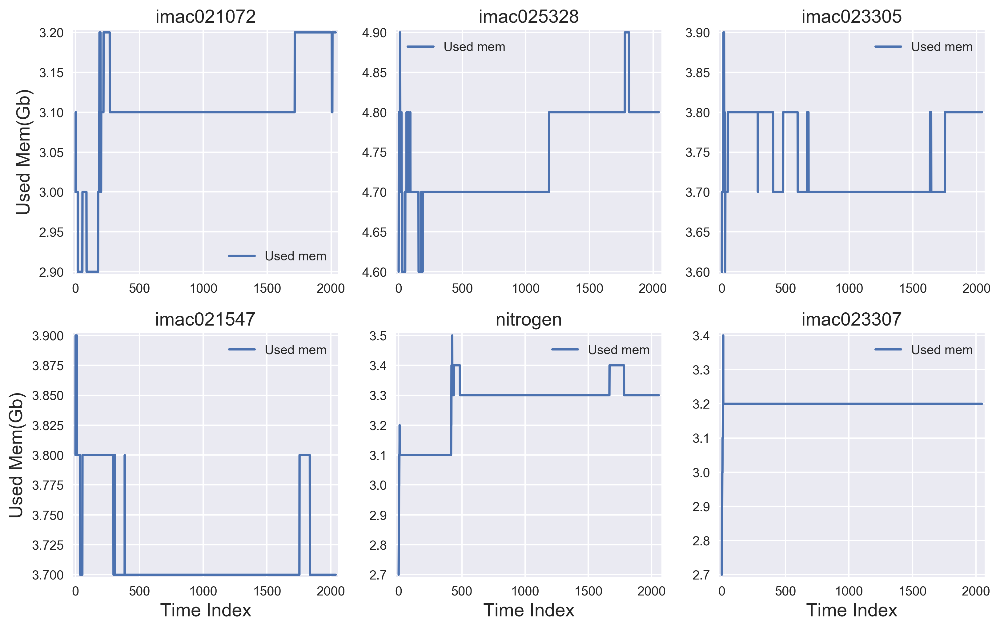

In [84]:
figs = plt.figure()
#genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
#genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

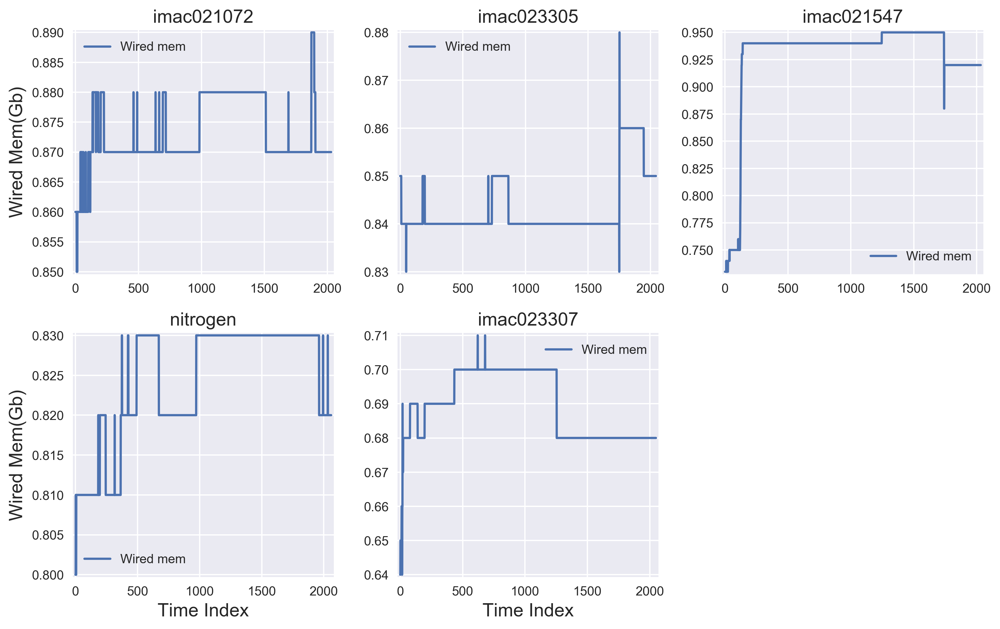

In [85]:
Dictt=get_ListOfDataFrameSift(PhMemStart)
llabel=[ "Time", "Used mem", "Wired mem", "Unused mem" ]
figs = plt.figure()
genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
#genplot(dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
#genplot(dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

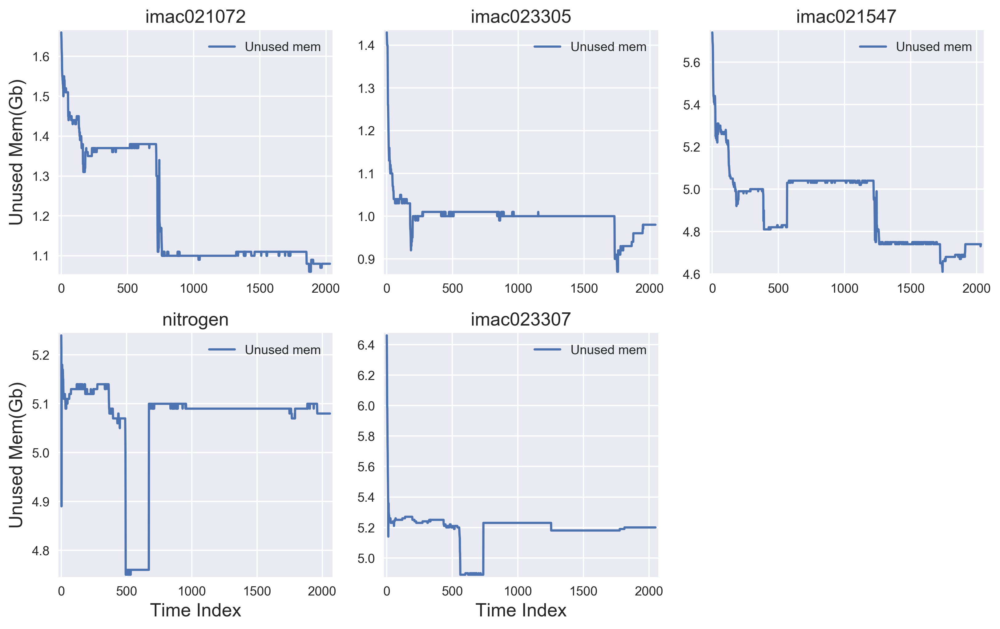

In [87]:
figs = plt.figure()
#genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
#genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

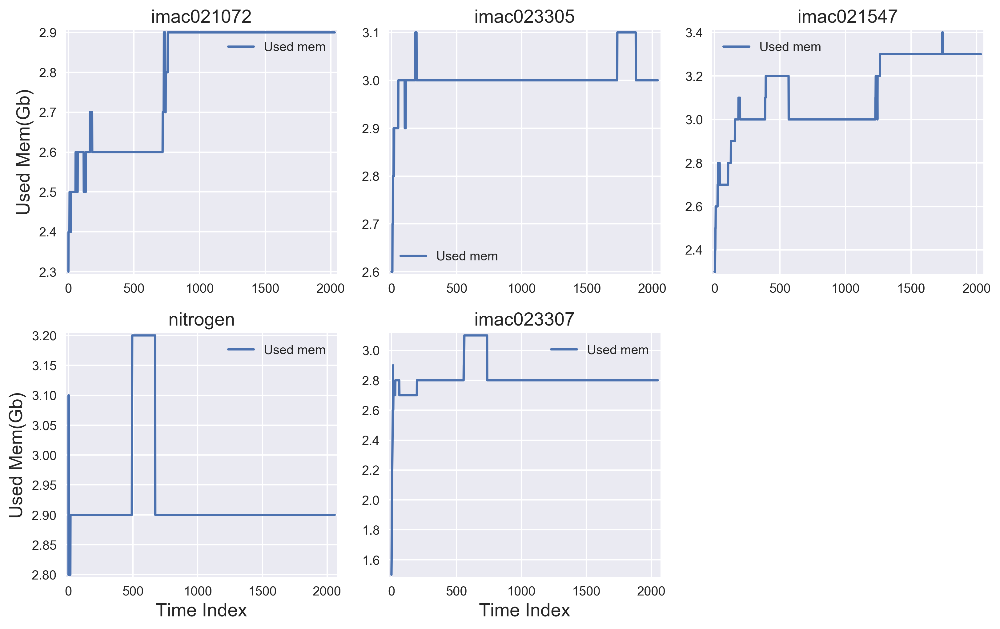

In [88]:
figs = plt.figure()
#genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
#genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

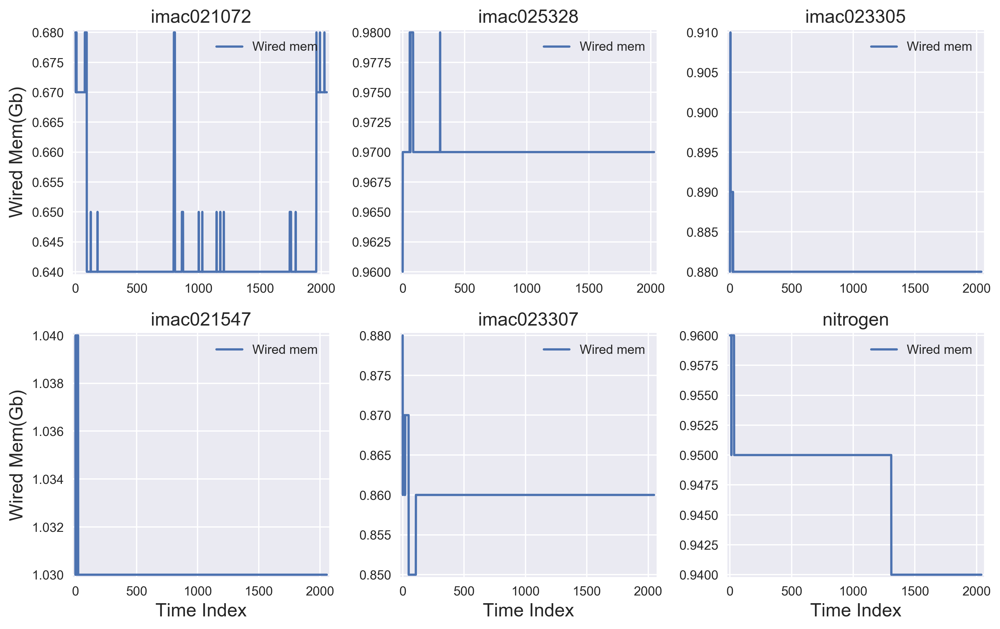

In [89]:
Dictt=get_ListOfDataFrameSift(PhMemLogDNS)
llabel=[ "Time", "Used mem", "Wired mem", "Unused mem" ]
figs = plt.figure()
genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
#genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
#genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

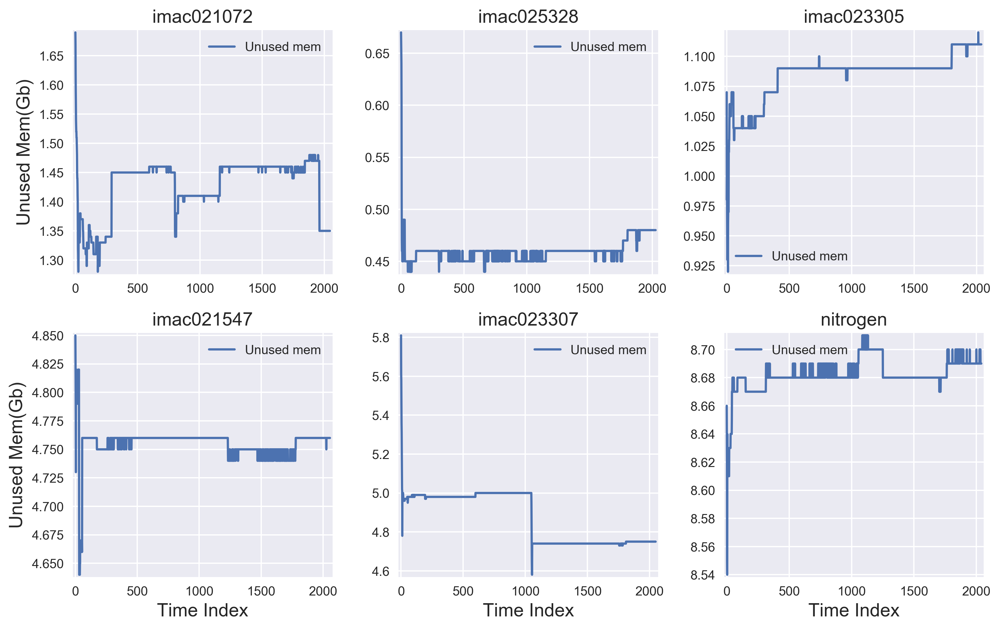

In [90]:
figs = plt.figure()
#genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
#genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

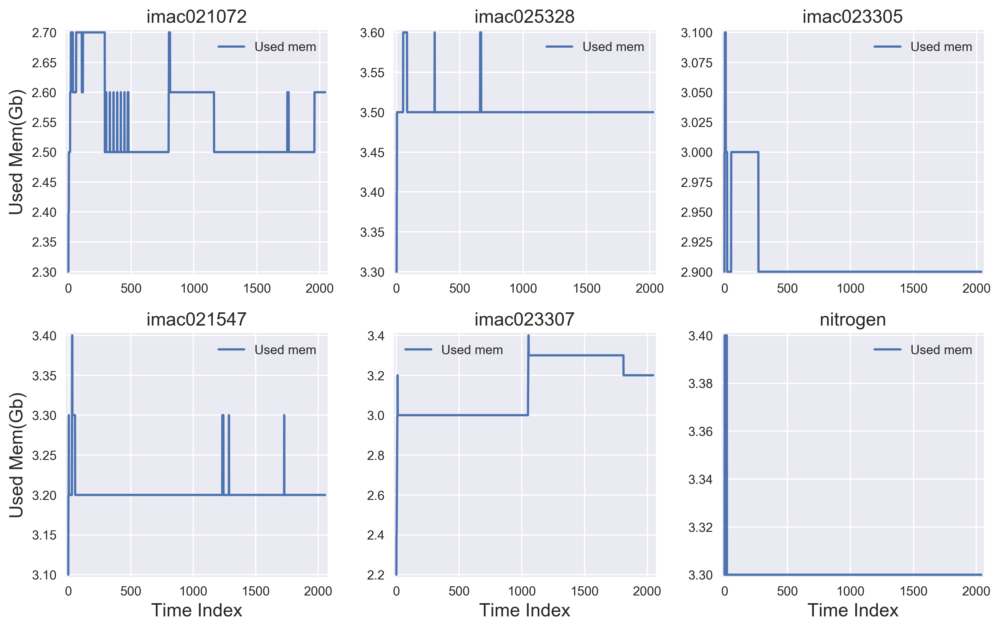

In [91]:
figs = plt.figure()
#genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
#genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

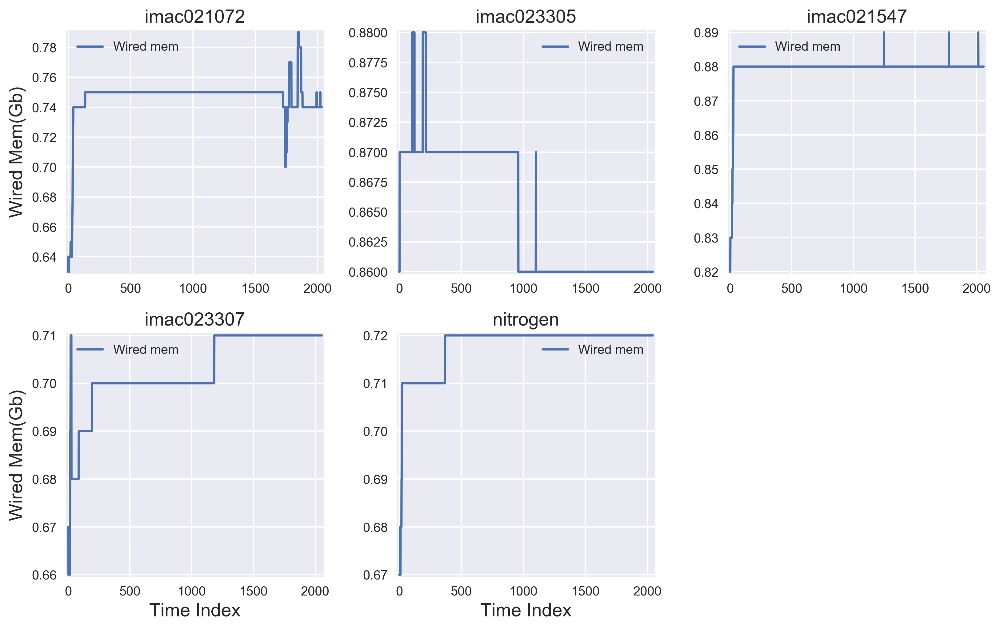

In [93]:
Dictt=get_ListOfDataFrameSift(PhMemStartDNS)
llabel=[ "Time", "Used mem", "Wired mem", "Unused mem" ]
figs = plt.figure()
genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
#genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
#genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

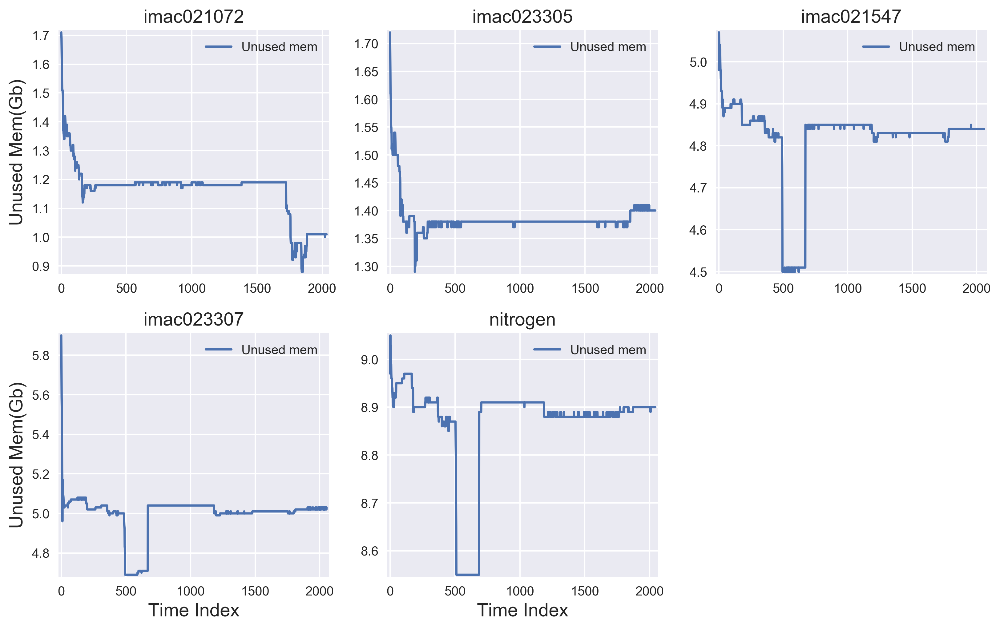

In [94]:
figs = plt.figure()
#genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
#genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

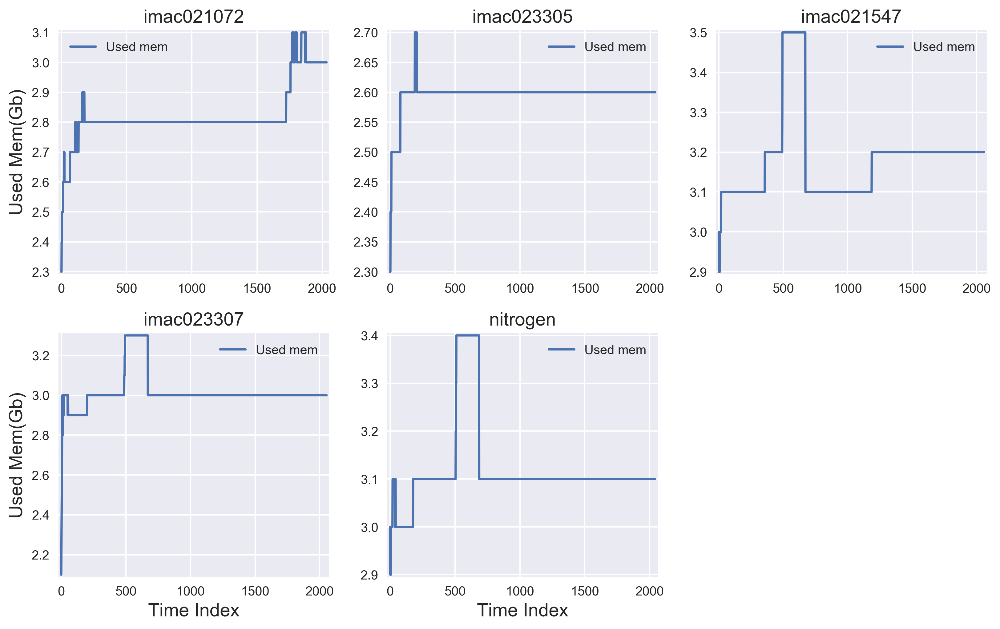

In [95]:
figs = plt.figure()
#genplot(Dictt,llabel,0,2,'Time Index','Wired Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)#wired
#genplot(Dictt,llabel,0,3,'Time Index','Unused Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Unused
genplot(Dictt,llabel,0,1,'Time Index','Used Mem(Gb)',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #Used
figs.set_size_inches(11,7)
figs.tight_layout()
figs.dpi=300

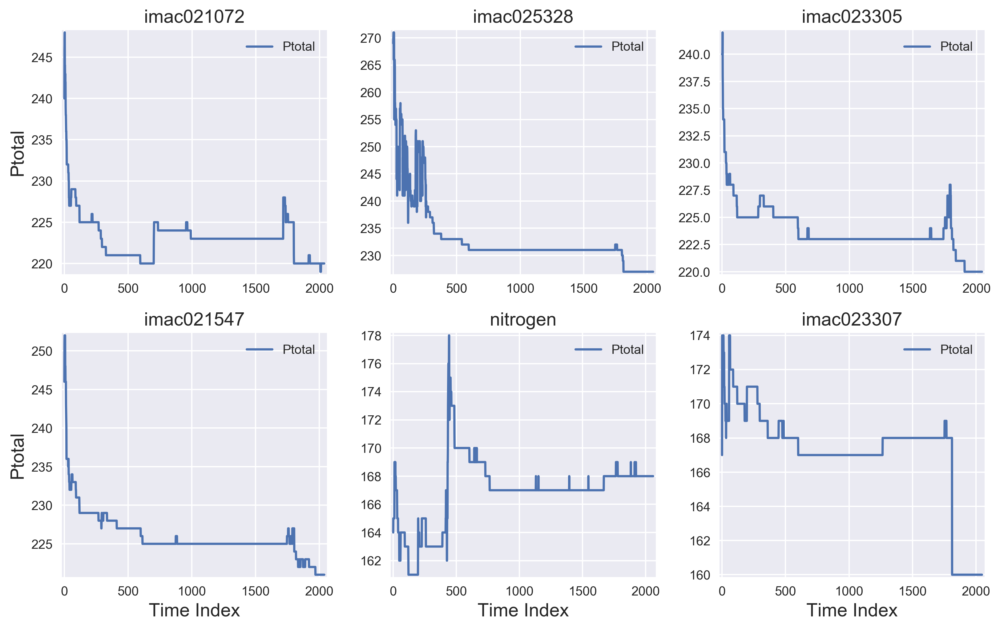

In [100]:
Dictt=get_ListOfDataFrameSift(ProcsLog)
#debug_print(dictt)
llabel=[ "Time", "Ptotal", "running", "stuck", "sleeping", "nthread"]
figmpl = plt.figure()
genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

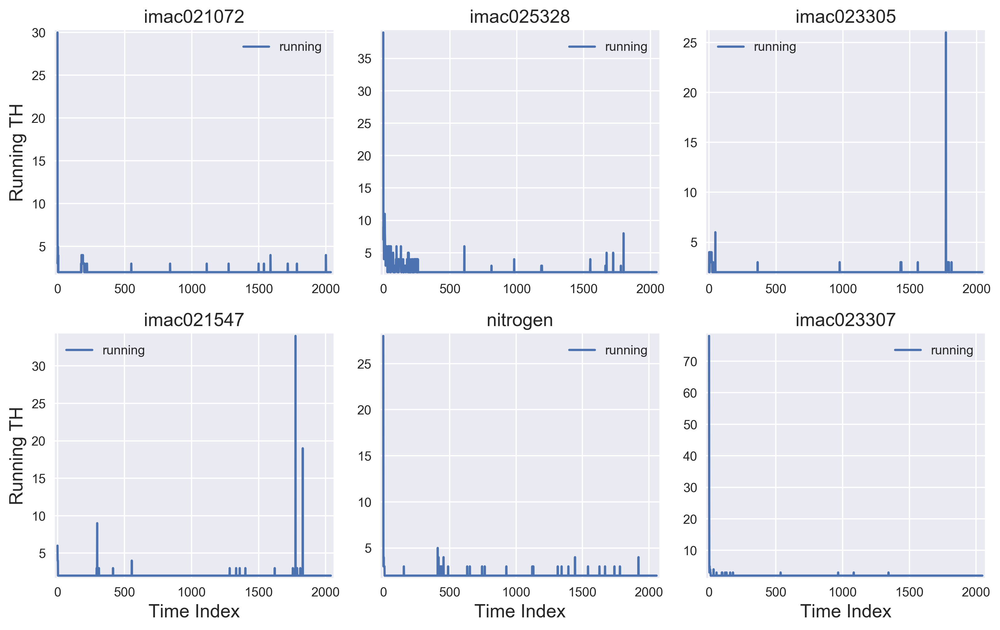

In [101]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

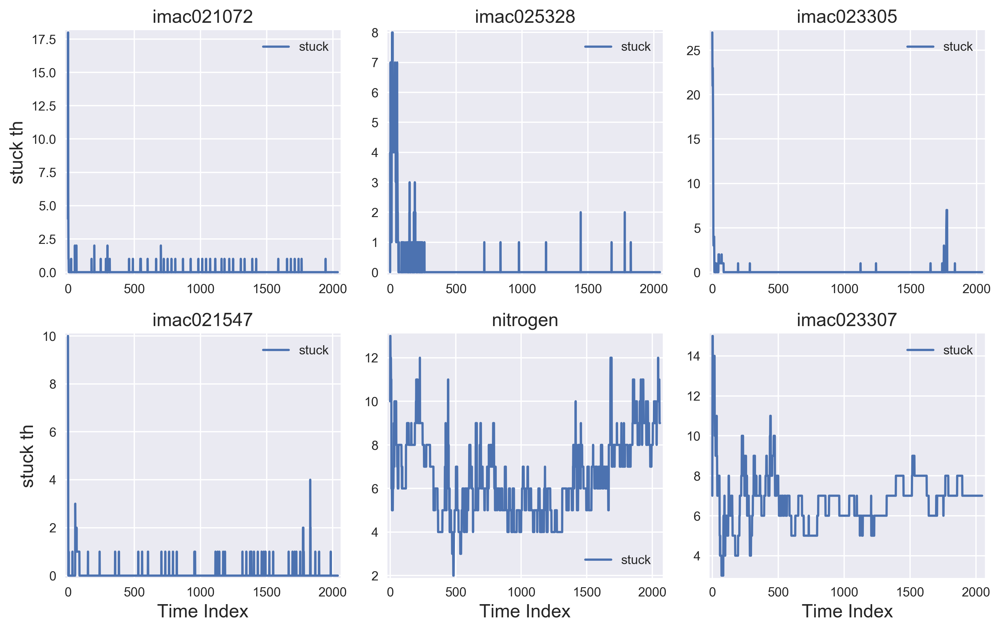

In [102]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

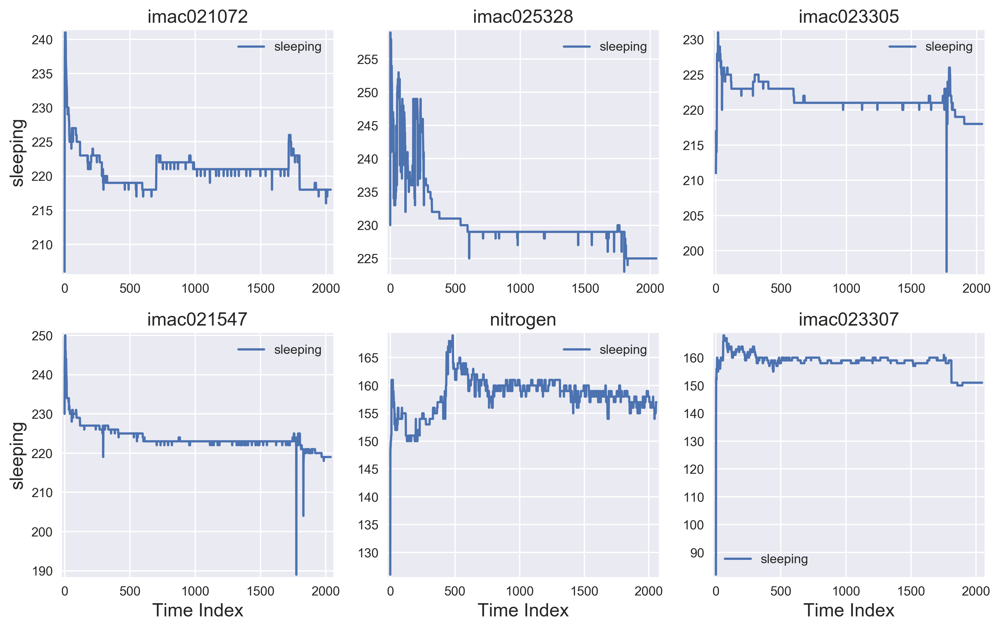

In [103]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

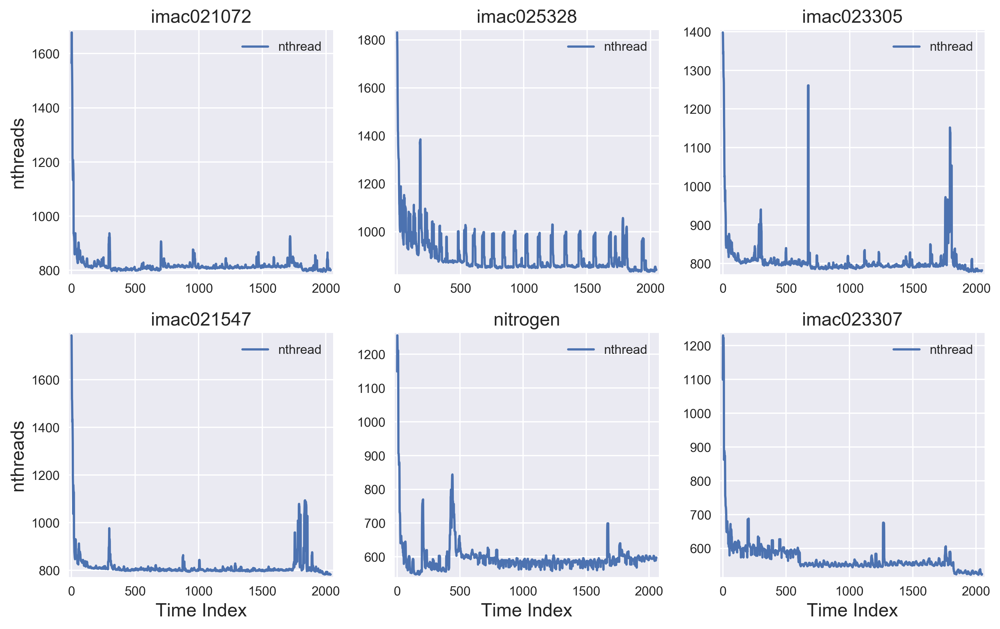

In [104]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

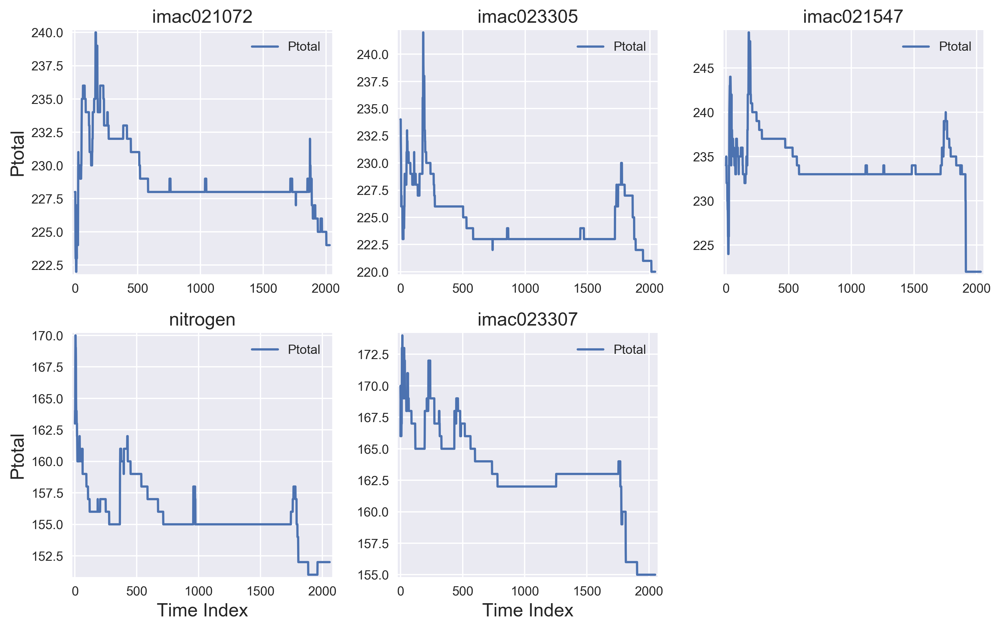

In [105]:
Dictt=get_ListOfDataFrameSift(ProcsStart)
#debug_print(dictt)
llabel=[ "Time", "Ptotal", "running", "stuck", "sleeping", "nthread"]
figmpl = plt.figure()
genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

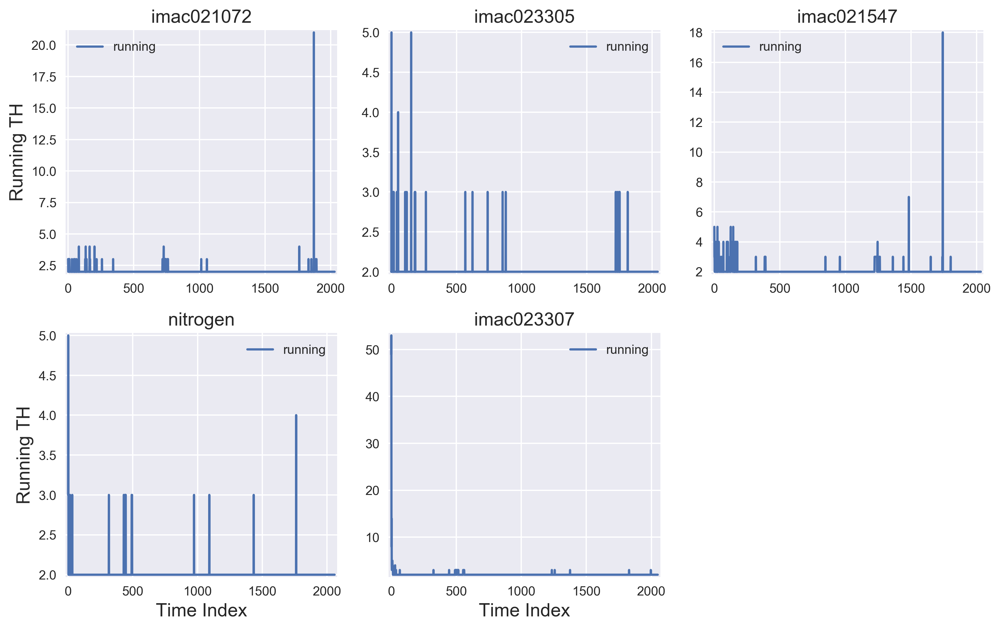

In [106]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

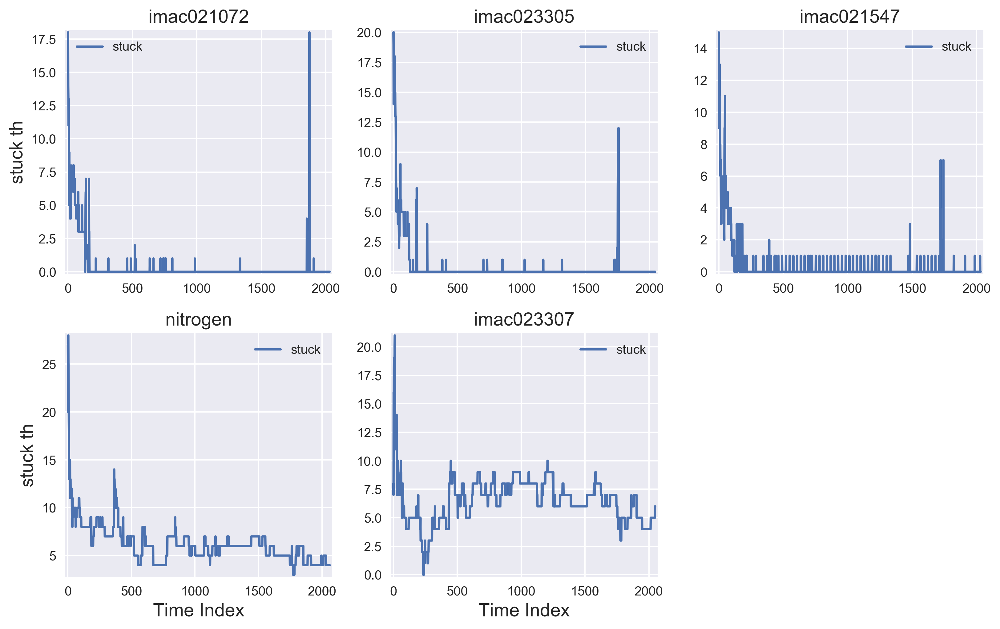

In [107]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

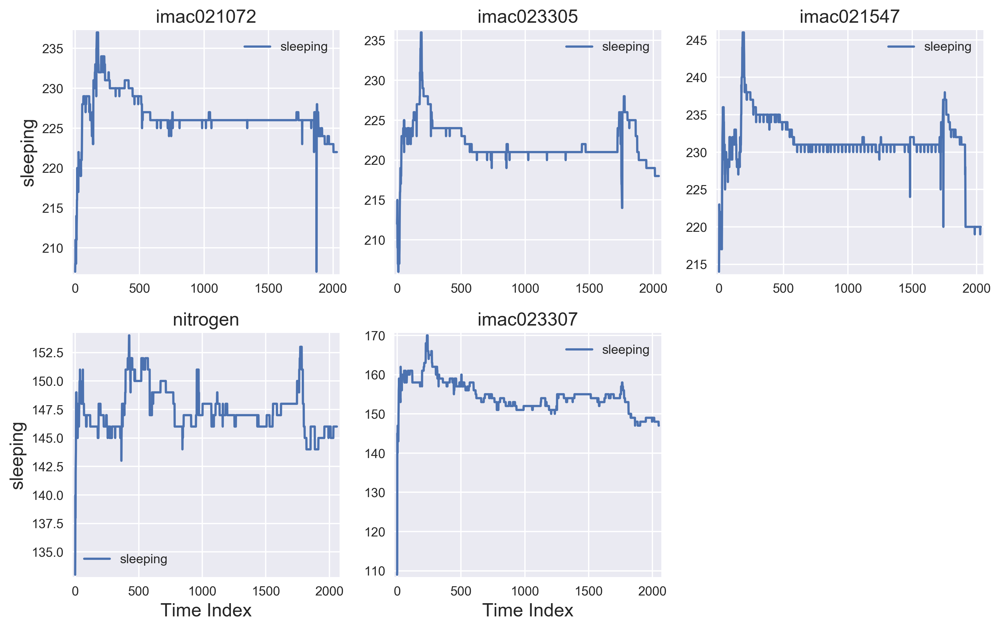

In [108]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

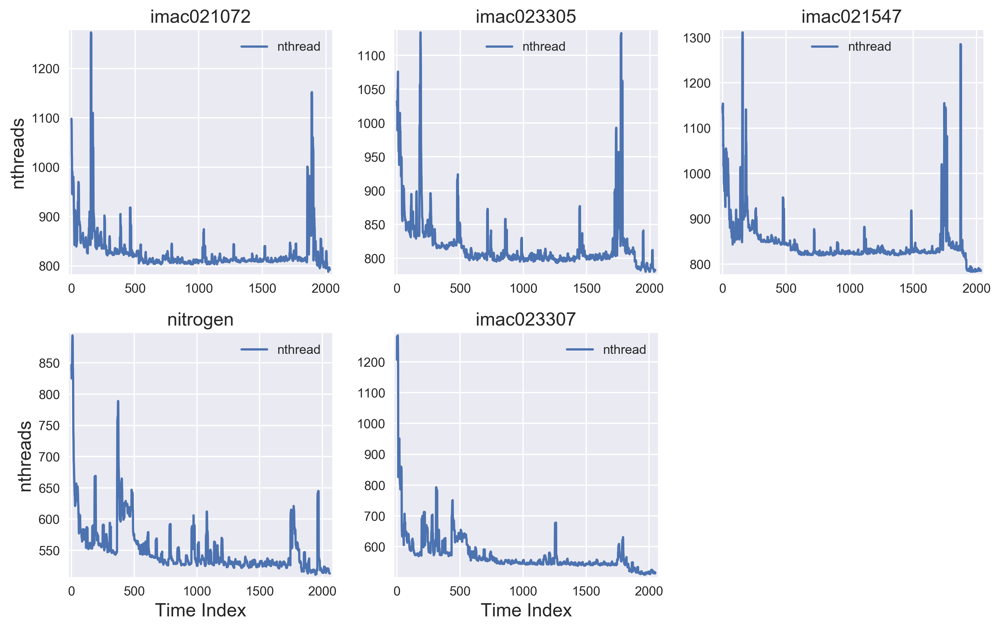

In [109]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

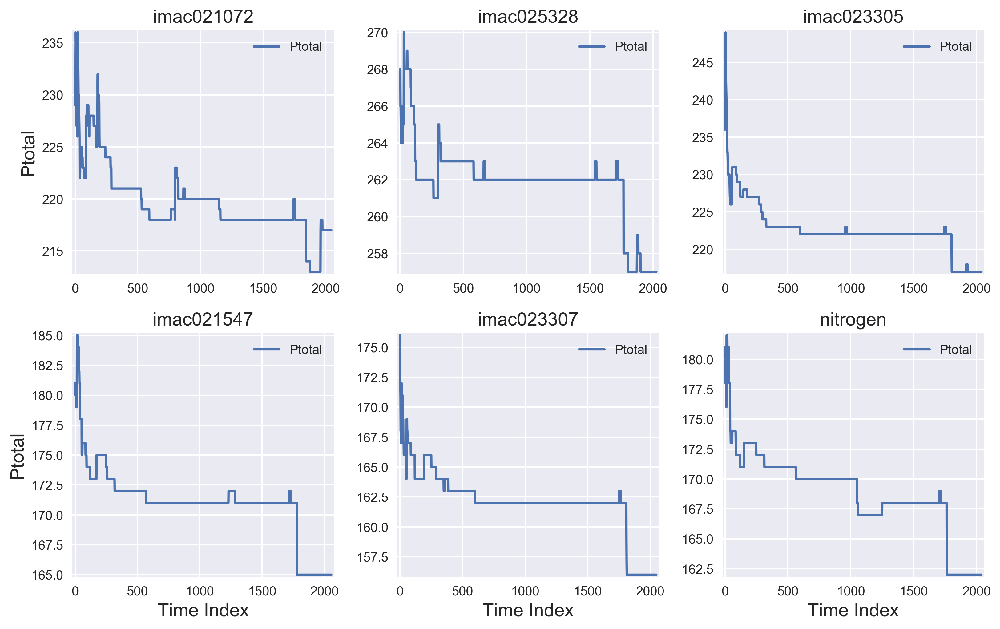

In [110]:
Dictt=get_ListOfDataFrameSift(ProcsLogDNS)
#debug_print(dictt)
figmpl = plt.figure()
genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

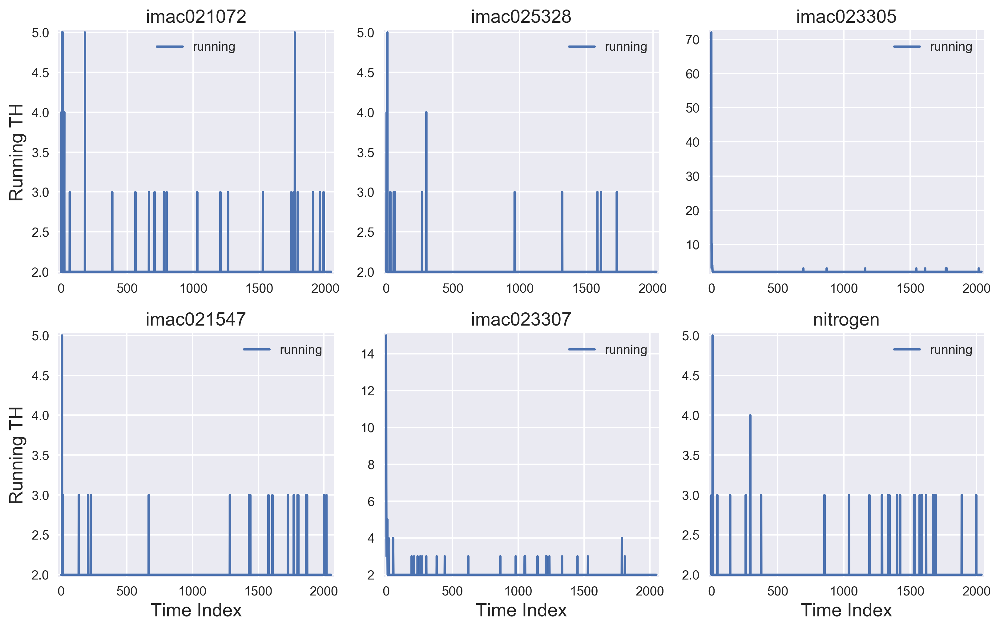

In [111]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

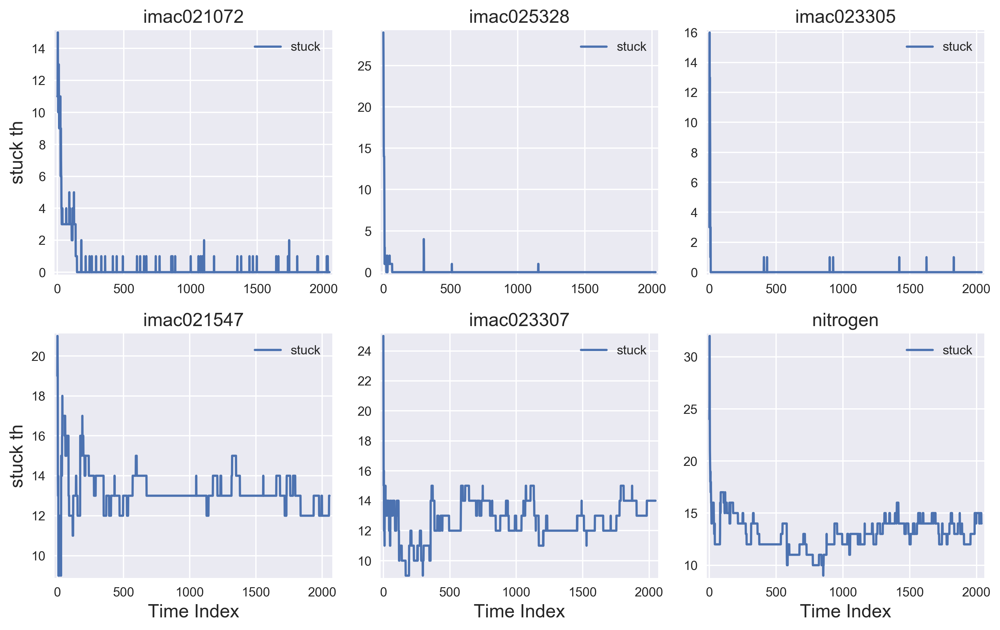

In [112]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

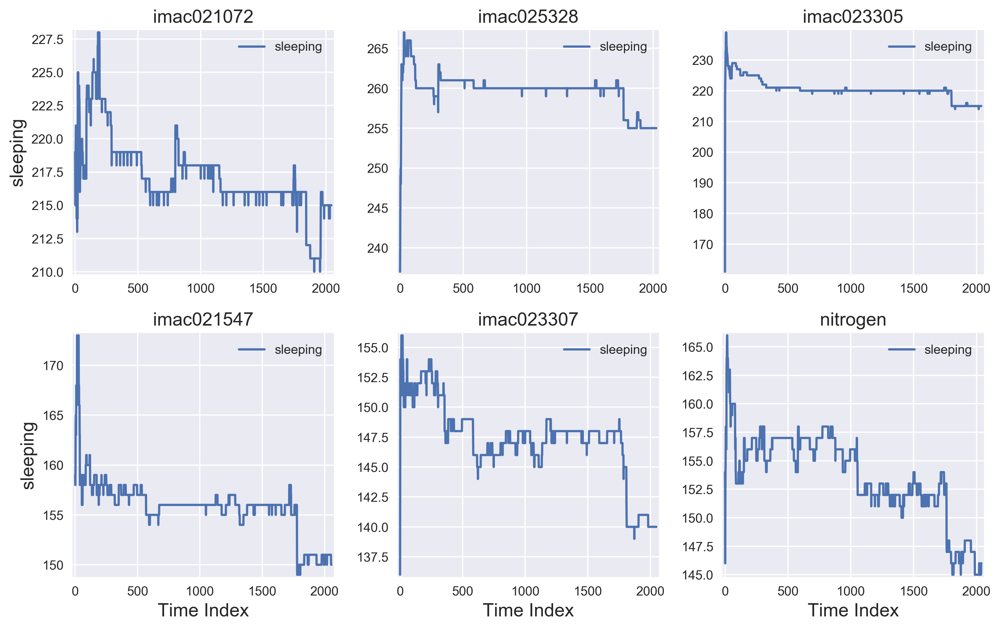

In [113]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

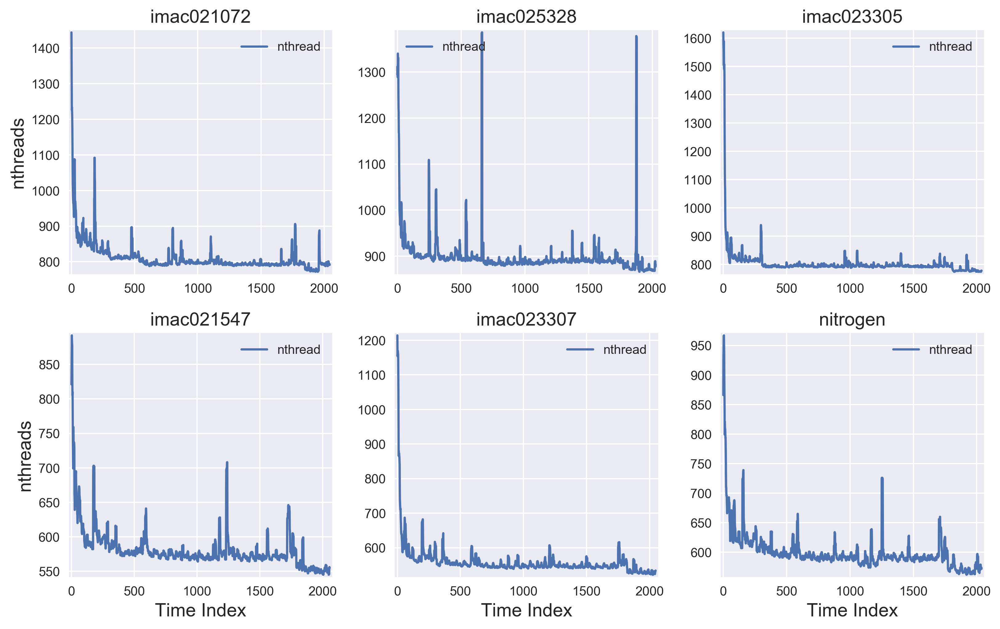

In [114]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

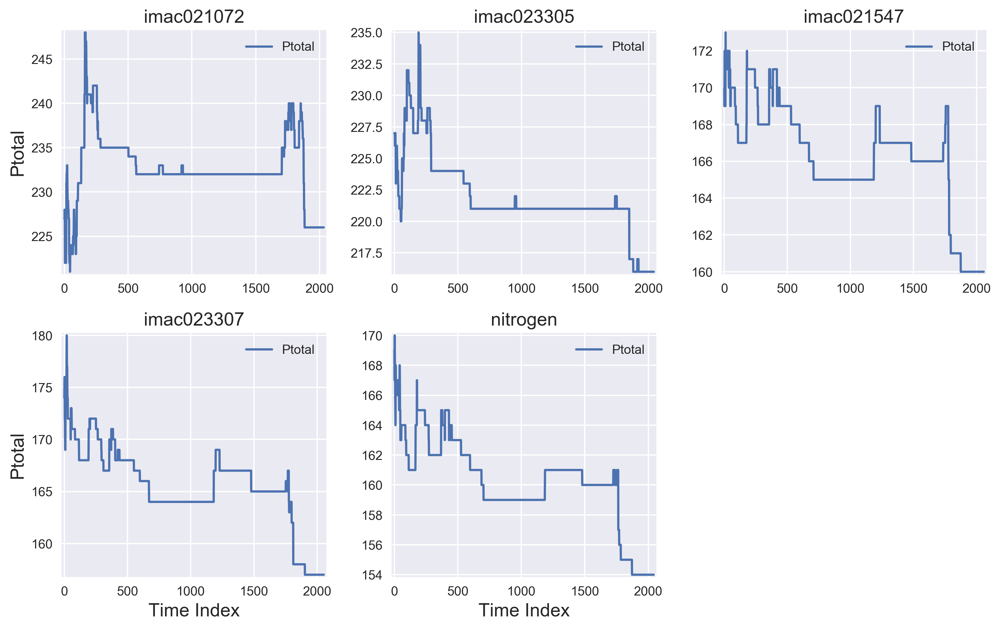

In [116]:
Dictt=get_ListOfDataFrameSift(ProcsStartDNS)
#debug_print(dictt)
figmpl = plt.figure()
genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

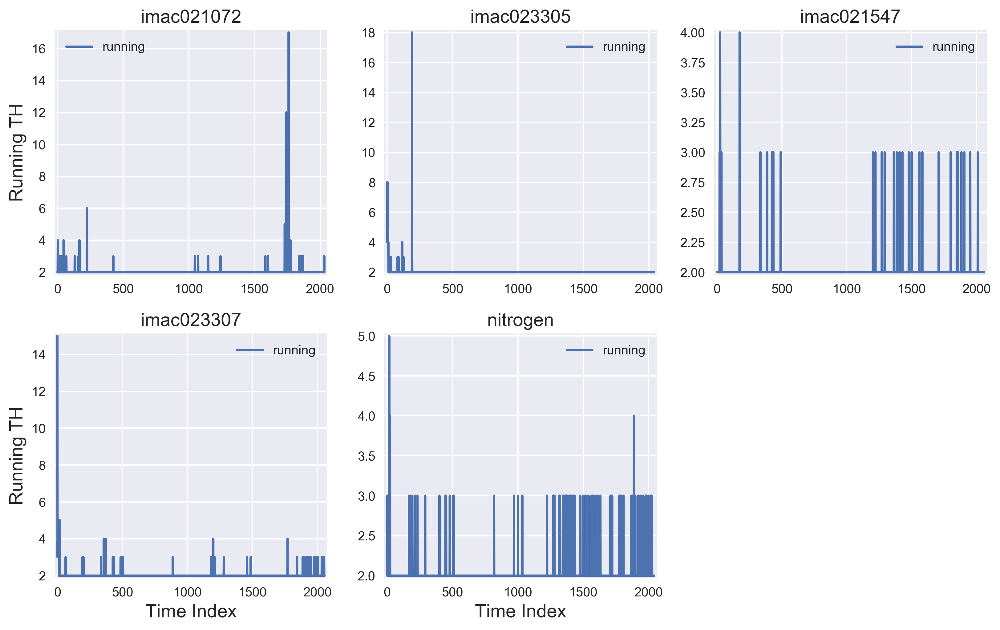

In [117]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

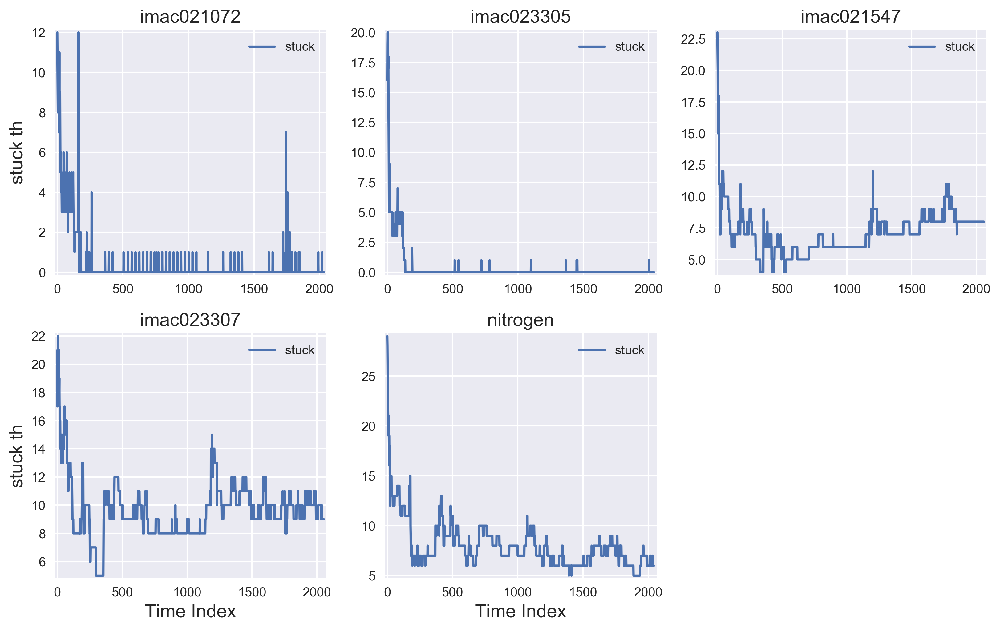

In [118]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

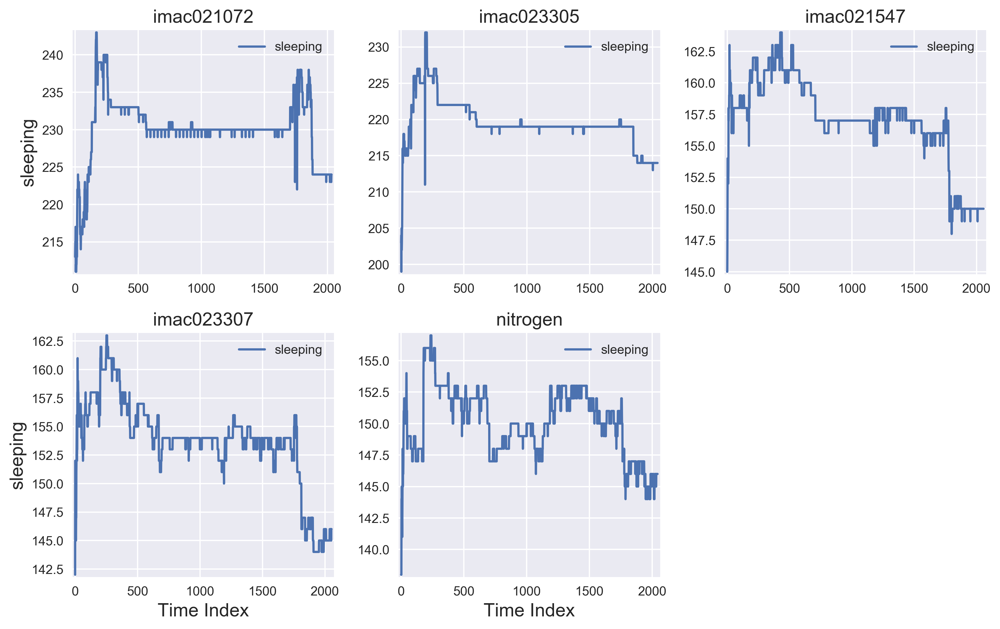

In [119]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
#genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300

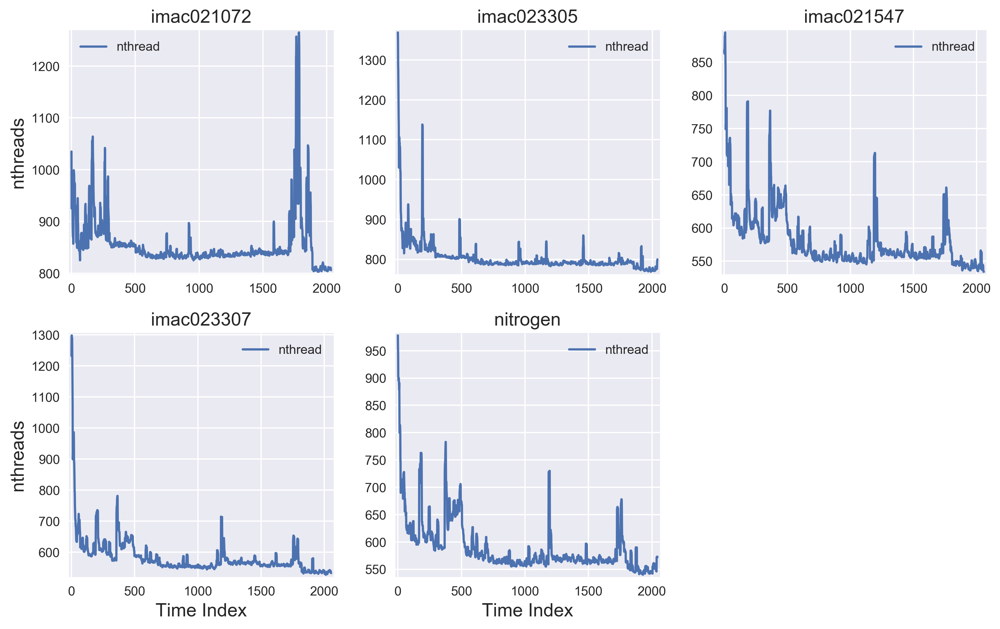

In [120]:
figmpl = plt.figure()
#genplot(Dictt,llabel,0,1,'Time Index','Ptotal',rrange,crange,sshape,sloc,sxlocchk,sylocchk) #ptotal
#genplot(Dictt,llabel,0,2,'Time Index','Running TH',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #running
#genplot(Dictt,llabel,0,3,'Time Index','stuck th',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #stuck
#genplot(Dictt,llabel,0,4,'Time Index','sleeping',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #sleeping
genplot(Dictt,llabel,0,5,'Time Index','nthreads',rrange,crange,sshape,sloc,sxlocchk,sylocchk)  #nthreads
figmpl.set_size_inches(11,7)
figmpl.tight_layout()
figmpl.dpi=300